In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import copy
%matplotlib inline

In [2]:
# Importing the data set
df=pd.read_csv("application_data.csv")
pd.set_option('display.max_columns', 150) # to display all the columns

In [3]:
'''
Exploring the data
'''
print("*****INFO******")
print(df.info())
print("\n*****SHAPE******")
print(df.shape)
print("\n*****COLUMNS******")
print(df.columns)

*****INFO******
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB
None

*****SHAPE******
(307511, 122)

*****COLUMNS******
Index(['SK_ID_CURR', 'TARGET', 'NAME_CONTRACT_TYPE', 'CODE_GENDER',
       'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY',
       ...
       'FLAG_DOCUMENT_18', 'FLAG_DOCUMENT_19', 'FLAG_DOCUMENT_20',
       'FLAG_DOCUMENT_21', 'AMT_REQ_CREDIT_BUREAU_HOUR',
       'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_WEEK',
       'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT',
       'AMT_REQ_CREDIT_BUREAU_YEAR'],
      dtype='object', length=122)


In [4]:
'''
Size of original dataset is (307511, 122)
Evaluating Percentage of Null values across various columns in the dataset
Also removing all those columns who have more then 30% null values as they will not be of much use in our analysis
'''
df = df[df.columns[ round(100*(df.isnull().sum()/len(df.index)), 2) < 30 ]]

'''
Evaluating Percentage of Null values across various rows in the dataset
Also removing all those rows who have more then 30% null values as they will not be of much use in our analysis
'''
print(len(df[round(100*(df.isnull().sum(axis=1)/df.shape[1]), 2) > 30 ].index))


0


In [5]:
'''
There are no rows in dataset which has more then 30% missing values
Finding final Dataset shape after removing null values
'''
print(df.shape)

(307511, 72)


Size of original dataset is (307511, 122)
Size of updated dataset is  (307511, 72)
which proves that we have removed columns in which high number of column values were empty, but even then we have plenty 
of data to analyze.

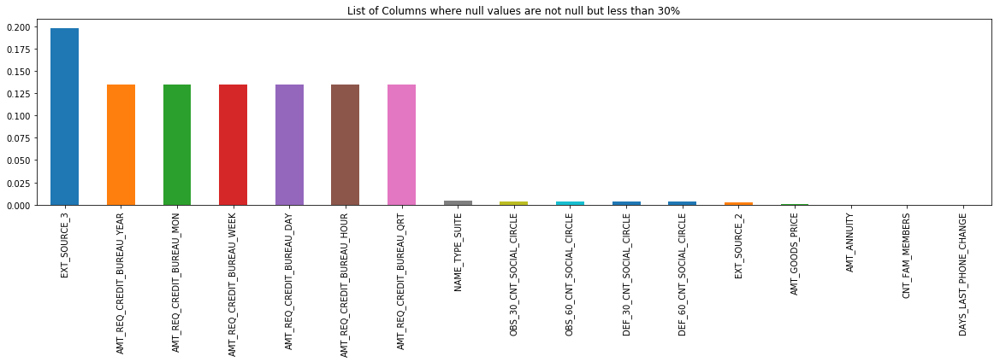

In [6]:
'''
Visualising columns with higher number of missing values
'''
Columns_with_Missing_values = df.isnull().mean()
# Only taking those columns where missing values are present
Columns_with_Missing_values = Columns_with_Missing_values[Columns_with_Missing_values.values > 0]
plt.figure(figsize=(20,4))
Columns_with_Missing_values.sort_values(ascending=False).plot(kind='bar')
plt.title('List of Columns where null values are not null but less than 30%')
plt.show()


In [7]:
'''
Now, lets try to impute values in those columns who have less then 30% missing values.
First, lets print such columns
'''
df[df.columns[ round(100*(df.isnull().sum()/len(df.index)), 2) > 0 ]].head()

,AMT_GOODS_PRICE,NAME_TYPE_SUITE,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,351000.0,Unaccompanied,0.262949,0.139376,2.0,2.0,2.0,2.0,0.0,0.0,0.0,0.0,0.0,1.0
1,1129500.0,Family,0.622246,NaN,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,135000.0,Unaccompanied,0.555912,0.729567,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,297000.0,Unaccompanied,0.650442,NaN,2.0,0.0,2.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
4,513000.0,Unaccompanied,0.322738,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [8]:
# AMT_GOODS_PRICE is of float datatype
print("Total number of Missing values in column is ", df.loc[:, "AMT_GOODS_PRICE"].isnull().sum())
# Imputing with mean is risky as outiers would always push mean to a faulty value
print("Standard Deviation of the column is ", df.loc[:, "AMT_GOODS_PRICE"].std())
print("Mean of the column is ", df.loc[:, "AMT_GOODS_PRICE"].mean())
print("Median of the column is", df.loc[:, "AMT_GOODS_PRICE"].median())

Total number of Missing values in column is  278
Standard Deviation of the column is  369446.4605400129
Mean of the column is  538396.2074288895
Median of the column is 450000.0


In [9]:
# A high standard deviation indicates that the data points are spread out over a wider range of values.
# So, we will be using Median to impute missing values
df.loc[np.isnan(df["AMT_GOODS_PRICE"]), ["AMT_GOODS_PRICE"]] = df["AMT_GOODS_PRICE"].median()

In [10]:
# Confirming whether all the NaN have been replacd with median
print(df.loc[:, "AMT_GOODS_PRICE"].isnull().sum())

0


{'whiskers': [<matplotlib.lines.Line2D at 0x2a6ecd84320>,
 'caps': [<matplotlib.lines.Line2D at 0x2a683f95390>,
 'boxes': [<matplotlib.lines.Line2D at 0x2a6ecd84358>],
 'medians': [<matplotlib.lines.Line2D at 0x2a683f955f8>],
 'fliers': [<matplotlib.lines.Line2D at 0x2a683f61b70>],
 'means': []}

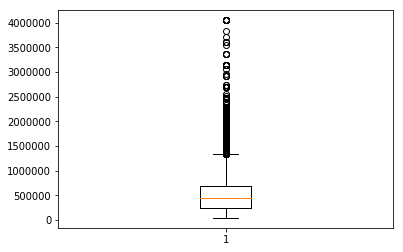

In [11]:
# Plotting the boxplot
plt.boxplot(df["AMT_GOODS_PRICE"])

In [12]:
# NAME_TYPE_SUITE is a Categorical value since it only takes small set of values
df["NAME_TYPE_SUITE"] = df["NAME_TYPE_SUITE"].astype("category")
df["NAME_TYPE_SUITE"].value_counts()

Unaccompanied      248526
Family              40149
Spouse, partner     11370
Children             3267
Other_B              1770
Other_A               866
Group of people       271
Name: NAME_TYPE_SUITE, dtype: int64

In [13]:
# Since Unaccompanied has largest number of entries in the column, we would be imputing missing values with it.
df.loc[pd.isnull(df["NAME_TYPE_SUITE"]), ["NAME_TYPE_SUITE"]] = "Unaccompanied"
# Checking missing values of column after imputing
print("Missing entries in column are ", df.loc[:, "AMT_GOODS_PRICE"].isnull().sum())

Missing entries in column are  0


In [14]:
'''
We took out rest of the columns which has missing values. We will analyze their min/max/sd values and based on that
we will be imputing NaN value(s)
'''
print("Min value is : ")
print(df[["EXT_SOURCE_2", "EXT_SOURCE_3", "OBS_30_CNT_SOCIAL_CIRCLE", "DEF_30_CNT_SOCIAL_CIRCLE", 
           "OBS_60_CNT_SOCIAL_CIRCLE", "DEF_60_CNT_SOCIAL_CIRCLE", "AMT_REQ_CREDIT_BUREAU_HOUR",
           "AMT_REQ_CREDIT_BUREAU_DAY", "AMT_REQ_CREDIT_BUREAU_WEEK", "AMT_REQ_CREDIT_BUREAU_MON",
           "AMT_REQ_CREDIT_BUREAU_QRT", "AMT_REQ_CREDIT_BUREAU_YEAR"]].min())

print("\nMax value is : ")
print(df[["EXT_SOURCE_2", "EXT_SOURCE_3", "OBS_30_CNT_SOCIAL_CIRCLE", "DEF_30_CNT_SOCIAL_CIRCLE", 
           "OBS_60_CNT_SOCIAL_CIRCLE", "DEF_60_CNT_SOCIAL_CIRCLE", "AMT_REQ_CREDIT_BUREAU_HOUR",
           "AMT_REQ_CREDIT_BUREAU_DAY", "AMT_REQ_CREDIT_BUREAU_WEEK", "AMT_REQ_CREDIT_BUREAU_MON",
           "AMT_REQ_CREDIT_BUREAU_QRT", "AMT_REQ_CREDIT_BUREAU_YEAR"]].max())

print("\nStandard Deviation is : ")
print(df[["EXT_SOURCE_2", "EXT_SOURCE_3", "OBS_30_CNT_SOCIAL_CIRCLE", "DEF_30_CNT_SOCIAL_CIRCLE", 
           "OBS_60_CNT_SOCIAL_CIRCLE", "DEF_60_CNT_SOCIAL_CIRCLE", "AMT_REQ_CREDIT_BUREAU_HOUR",
           "AMT_REQ_CREDIT_BUREAU_DAY", "AMT_REQ_CREDIT_BUREAU_WEEK", "AMT_REQ_CREDIT_BUREAU_MON",
           "AMT_REQ_CREDIT_BUREAU_QRT", "AMT_REQ_CREDIT_BUREAU_YEAR"]].std())

Min value is : 
EXT_SOURCE_2                  8.173617e-08
EXT_SOURCE_3                  5.272652e-04
OBS_30_CNT_SOCIAL_CIRCLE      0.000000e+00
DEF_30_CNT_SOCIAL_CIRCLE      0.000000e+00
OBS_60_CNT_SOCIAL_CIRCLE      0.000000e+00
DEF_60_CNT_SOCIAL_CIRCLE      0.000000e+00
AMT_REQ_CREDIT_BUREAU_HOUR    0.000000e+00
AMT_REQ_CREDIT_BUREAU_DAY     0.000000e+00
AMT_REQ_CREDIT_BUREAU_WEEK    0.000000e+00
AMT_REQ_CREDIT_BUREAU_MON     0.000000e+00
AMT_REQ_CREDIT_BUREAU_QRT     0.000000e+00
AMT_REQ_CREDIT_BUREAU_YEAR    0.000000e+00
dtype: float64

Max value is : 
EXT_SOURCE_2                    0.85500
EXT_SOURCE_3                    0.89601
OBS_30_CNT_SOCIAL_CIRCLE      348.00000
DEF_30_CNT_SOCIAL_CIRCLE       34.00000
OBS_60_CNT_SOCIAL_CIRCLE      344.00000
DEF_60_CNT_SOCIAL_CIRCLE       24.00000
AMT_REQ_CREDIT_BUREAU_HOUR      4.00000
AMT_REQ_CREDIT_BUREAU_DAY       9.00000
AMT_REQ_CREDIT_BUREAU_WEEK      8.00000
AMT_REQ_CREDIT_BUREAU_MON      27.00000
AMT_REQ_CREDIT_BUREAU_QRT     261.00

In [15]:
# After analysing the data, it seems that outliers might be present in following columns.
# Example Max value is hugely greater then normal values, and comparebly standard deviation also seems large
# So imputing with median
columns = ["OBS_30_CNT_SOCIAL_CIRCLE", "DEF_30_CNT_SOCIAL_CIRCLE", "OBS_60_CNT_SOCIAL_CIRCLE",
           "DEF_60_CNT_SOCIAL_CIRCLE", "AMT_REQ_CREDIT_BUREAU_QRT"]
for col in columns:
    df.loc[np.isnan(df[col]), [col]] = df[col].median()

In [16]:
# After analysing the data, it seems that outliers are not present in following columns.
# Example Max value feels like within range, and standard deviation is also less
# So imputing with mean
columns = ["EXT_SOURCE_2", "EXT_SOURCE_3", "AMT_REQ_CREDIT_BUREAU_HOUR", "AMT_REQ_CREDIT_BUREAU_DAY", 
           "AMT_REQ_CREDIT_BUREAU_WEEK", "AMT_REQ_CREDIT_BUREAU_MON", "AMT_REQ_CREDIT_BUREAU_YEAR"]
for col in columns:
    df.loc[np.isnan(df[col]), [col]] = df[col].mean()

In [17]:
'''
Since columns have been imputed, lets check whether any column is still left with NaN values
'''
df[df.columns[ round(100*(df.isnull().sum()/len(df.index)), 2) > 0 ]].head()

""
0
1
2
3
4


In [18]:
print("Shape of the dataframe is ", df.shape)
print("\nRows having missing values in rows\n", df[df.isnull().sum(axis=1) > 0].index)
print("\nRows having missing values in rows\n", len(df[df.isnull().sum(axis=1) > 0].index))

Shape of the dataframe is  (307511, 72)

Rows having missing values in rows
 Int64Index([ 15709,  41982,  47531,  50035,  51594,  55025,  59934,  75873,
             89343, 123872, 187348, 207186, 227939, 239329, 241835],
           dtype='int64')

Rows having missing values in rows
 15


In [19]:
'''
There are only 15 rows which contains missing values.
Since, we have already imputed missing columns, and we have more then 3 lakhs rows, so we can delete such rows
'''
df=df[df.isnull().sum(axis=1) == 0]
print("Updated Shape of the dataframe is ", df.shape)

Updated Shape of the dataframe is  (307496, 72)


In [20]:
# DataFrame info about columns. Lets make sure that type of data frame columns is correctly updated
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 307496 entries, 0 to 307510
Data columns (total 72 columns):
SK_ID_CURR                     307496 non-null int64
TARGET                         307496 non-null int64
NAME_CONTRACT_TYPE             307496 non-null object
CODE_GENDER                    307496 non-null object
FLAG_OWN_CAR                   307496 non-null object
FLAG_OWN_REALTY                307496 non-null object
CNT_CHILDREN                   307496 non-null int64
AMT_INCOME_TOTAL               307496 non-null float64
AMT_CREDIT                     307496 non-null float64
AMT_ANNUITY                    307496 non-null float64
AMT_GOODS_PRICE                307496 non-null float64
NAME_TYPE_SUITE                307496 non-null category
NAME_INCOME_TYPE               307496 non-null object
NAME_EDUCATION_TYPE            307496 non-null object
NAME_FAMILY_STATUS             307496 non-null object
NAME_HOUSING_TYPE              307496 non-null object
REGION_POPULATION_RELA

In [21]:
'''
After analysing following columns, they seem to be of category type
'''
category_columns = ["FLAG_MOBIL", "FLAG_EMP_PHONE", "FLAG_WORK_PHONE", "NAME_CONTRACT_TYPE", "CODE_GENDER", "FLAG_OWN_CAR", 
            "FLAG_CONT_MOBILE", "FLAG_PHONE", "FLAG_EMAIL", "FLAG_OWN_REALTY", "NAME_INCOME_TYPE", 
            "NAME_EDUCATION_TYPE", "NAME_FAMILY_STATUS", "NAME_HOUSING_TYPE", "WEEKDAY_APPR_PROCESS_START", 
            "ORGANIZATION_TYPE", "TARGET", "FLAG_DOCUMENT_2", "FLAG_DOCUMENT_3", "FLAG_DOCUMENT_4", "FLAG_DOCUMENT_5", 
            "FLAG_DOCUMENT_6", "FLAG_DOCUMENT_7", "FLAG_DOCUMENT_8", "FLAG_DOCUMENT_9", "FLAG_DOCUMENT_10", 
            "FLAG_DOCUMENT_11", "FLAG_DOCUMENT_12", "FLAG_DOCUMENT_13", "FLAG_DOCUMENT_14", "FLAG_DOCUMENT_15", 
            "FLAG_DOCUMENT_16", "FLAG_DOCUMENT_17", "FLAG_DOCUMENT_18", "FLAG_DOCUMENT_19", "FLAG_DOCUMENT_20", 
            "FLAG_DOCUMENT_21", "REGION_RATING_CLIENT", "REGION_RATING_CLIENT_W_CITY", "REG_REGION_NOT_LIVE_REGION", 
            "REG_REGION_NOT_WORK_REGION", "LIVE_REGION_NOT_WORK_REGION", "REG_CITY_NOT_LIVE_CITY", "REG_CITY_NOT_WORK_CITY",
            "LIVE_CITY_NOT_WORK_CITY"]
for col in category_columns:
    df[col] = df[col].astype('category')

In [22]:
# DataFrame info about columns. Lets make sure that type of data frame columns is correctly updated
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 307496 entries, 0 to 307510
Data columns (total 72 columns):
SK_ID_CURR                     307496 non-null int64
TARGET                         307496 non-null category
NAME_CONTRACT_TYPE             307496 non-null category
CODE_GENDER                    307496 non-null category
FLAG_OWN_CAR                   307496 non-null category
FLAG_OWN_REALTY                307496 non-null category
CNT_CHILDREN                   307496 non-null int64
AMT_INCOME_TOTAL               307496 non-null float64
AMT_CREDIT                     307496 non-null float64
AMT_ANNUITY                    307496 non-null float64
AMT_GOODS_PRICE                307496 non-null float64
NAME_TYPE_SUITE                307496 non-null category
NAME_INCOME_TYPE               307496 non-null category
NAME_EDUCATION_TYPE            307496 non-null category
NAME_FAMILY_STATUS             307496 non-null category
NAME_HOUSING_TYPE              307496 non-null category
REG

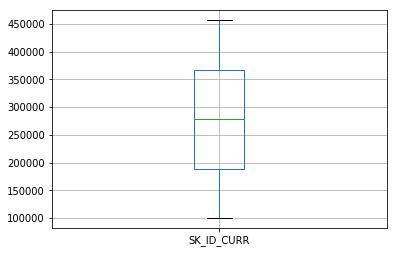

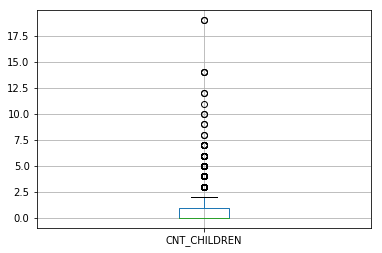

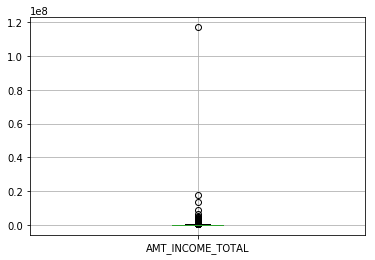

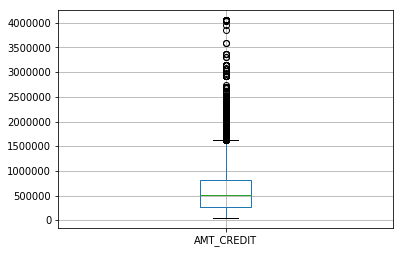

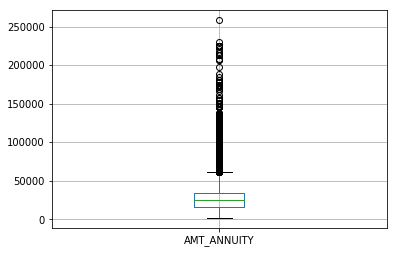

...

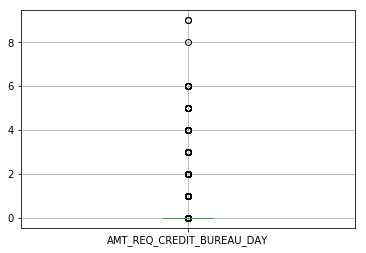

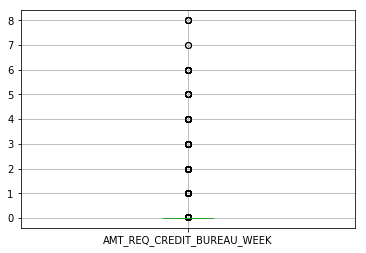

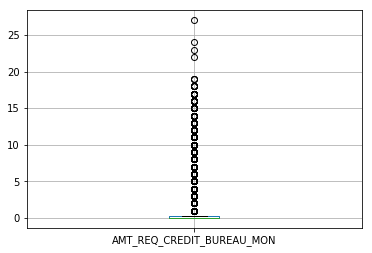

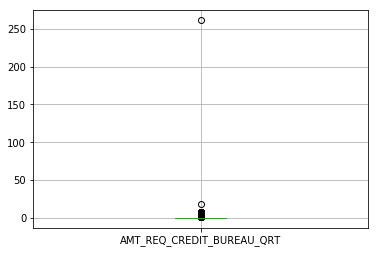

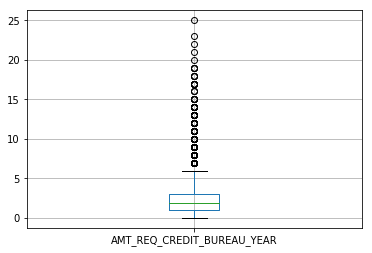

In [23]:
'''
As seen while imputing, there seems to be outlier presents across different numeric columns.
If outliers are removed, they will cause issues in our analysation process.
Lets visualize them through boxplot first
'''
numeric=["float64", "int64"]
for col in df.select_dtypes(include=numeric).columns:
        plt.figure()
        df.boxplot([col])
        plt.show()


In [24]:
df.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,1,1,0,1,1,0,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000000,0.000,0.000000,0.000000,0.0,1.000000
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,1,1,0,1,1,0,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,0.510853,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000000,0.000,0.000000,0.000000,0.0,0.000000
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,1,1,1,1,1,0,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,0.555912,0.729567,0.0,0.0,0.0,0.0,-815.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000000,0.000,0.000000,0.000000,0.0,0.000000
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,-19005,-3039,-9833.0,-2437,1,1,0,1,0,0,2.0,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,0.650442,0.510853,2.0,0.0,2.0,0.0,-617.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.006402,0.007,0.034362,0.267395,0.0,1.899974
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,-19932,-3038,-4311.0,-3458,1,1,0,1,0,0,1.0,2,2,THURSDAY,11,0,0,0,0,1,1,Religion,0.322738,0.510853,0.0,0.0,0.0,0.0,-1106.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000000,0.000,0.000000,0.000000,0.0,0.000000


In [25]:
# Setting SK_ID_CURR as the index of the dataframe so that its easier to join and read/analyze data
df.set_index("SK_ID_CURR", inplace=True)
df.head()

,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,1,1,0,1,1,0,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000000,0.000,0.000000,0.000000,0.0,1.000000
100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,1,1,0,1,1,0,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,0.510853,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000000,0.000,0.000000,0.000000,0.0,0.000000
100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,1,1,1,1,1,0,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,0.555912,0.729567,0.0,0.0,0.0,0.0,-815.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000000,0.000,0.000000,0.000000,0.0,0.000000
100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,-19005,-3039,-9833.0,-2437,1,1,0,1,0,0,2.0,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,0.650442,0.510853,2.0,0.0,2.0,0.0,-617.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.006402,0.007,0.034362,0.267395,0.0,1.899974
100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,-19932,-3038,-4311.0,-3458,1,1,0,1,0,0,1.0,2,2,THURSDAY,11,0,0,0,0,1,1,Religion,0.322738,0.510853,0.0,0.0,0.0,0.0,-1106.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000000,0.000,0.000000,0.000000,0.0,0.000000


In [26]:
'''
As seen in above figures too, there seems to be many outliers present across columns.
Lets remove outliers present in int and float columns
'''
numeric=["float64", "int64"]
desired_col=[]
for col in df.select_dtypes(include=numeric).columns:
    if col != "SK_ID_CURR":
        desired_col.append(col)
df_excluded = df.loc[:, desired_col]
df_excluded.head()

,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,CNT_FAM_MEMBERS,HOUR_APPR_PROCESS_START,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,,,,,
100002,0,202500.0,406597.5,24700.5,351000.0,0.018801,-9461,-637,-3648.0,-2120,1.0,10,0.262949,0.139376,2.0,2.0,2.0,2.0,-1134.0,0.000000,0.000,0.000000,0.000000,0.0,1.000000
100003,0,270000.0,1293502.5,35698.5,1129500.0,0.003541,-16765,-1188,-1186.0,-291,2.0,11,0.622246,0.510853,1.0,0.0,1.0,0.0,-828.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000
100004,0,67500.0,135000.0,6750.0,135000.0,0.010032,-19046,-225,-4260.0,-2531,1.0,9,0.555912,0.729567,0.0,0.0,0.0,0.0,-815.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000
100006,0,135000.0,312682.5,29686.5,297000.0,0.008019,-19005,-3039,-9833.0,-2437,2.0,17,0.650442,0.510853,2.0,0.0,2.0,0.0,-617.0,0.006402,0.007,0.034362,0.267395,0.0,1.899974
100007,0,121500.0,513000.0,21865.5,513000.0,0.028663,-19932,-3038,-4311.0,-3458,1.0,11,0.322738,0.510853,0.0,0.0,0.0,0.0,-1106.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000


In [27]:
print("Shape of the dataframe is ", df.shape)
print("\nRows having missing values in rows\n", len(df_excluded[df_excluded.isnull().sum(axis=1) > 0].index))
print("\nRows having missing values in rows\n", df_excluded.isnull().sum() > 0)

Shape of the dataframe is  (307496, 71)

Rows having missing values in rows
 0

Rows having missing values in rows
 CNT_CHILDREN                  False
AMT_INCOME_TOTAL              False
AMT_CREDIT                    False
AMT_ANNUITY                   False
AMT_GOODS_PRICE               False
REGION_POPULATION_RELATIVE    False
DAYS_BIRTH                    False
DAYS_EMPLOYED                 False
DAYS_REGISTRATION             False
DAYS_ID_PUBLISH               False
CNT_FAM_MEMBERS               False
HOUR_APPR_PROCESS_START       False
EXT_SOURCE_2                  False
EXT_SOURCE_3                  False
OBS_30_CNT_SOCIAL_CIRCLE      False
DEF_30_CNT_SOCIAL_CIRCLE      False
OBS_60_CNT_SOCIAL_CIRCLE      False
DEF_60_CNT_SOCIAL_CIRCLE      False
DAYS_LAST_PHONE_CHANGE        False
AMT_REQ_CREDIT_BUREAU_HOUR    False
AMT_REQ_CREDIT_BUREAU_DAY     False
AMT_REQ_CREDIT_BUREAU_WEEK    False
AMT_REQ_CREDIT_BUREAU_MON     False
AMT_REQ_CREDIT_BUREAU_QRT     False
AMT_REQ_CREDIT_BUREA

In [28]:
df_excluded.describe()

,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,CNT_FAM_MEMBERS,HOUR_APPR_PROCESS_START,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307496.000000,3.074960e+05,3.074960e+05,307496.000000,3.074960e+05,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,3.074960e+05,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000,307496.000000
mean,0.417072,1.687963e+05,5.990281e+05,27108.549241,5.383189e+05,0.020868,-16037.100707,63818.252094,-4986.126746,-2994.218507,2.152682,12.063328,5.143895e-01,0.510856,1.417570,0.142951,1.400672,0.099722,-962.863400,0.006403,0.007000,0.034354,0.267386,0.229632,1.899935
std,0.722133,2.371280e+05,4.024942e+05,14493.802393,3.692923e+05,0.013831,4363.992221,141278.466175,3522.867752,1509.451425,0.910693,3.265852,1.908558e-01,0.174465,2.398438,0.446042,2.377267,0.361743,826.811646,0.077985,0.103012,0.190347,0.851933,0.744072,1.738457
min,0.000000,2.565000e+04,4.500000e+04,1615.500000,4.050000e+04,0.000290,-25229.000000,-17912.000000,-24672.000000,-7197.000000,1.000000,0.000000,8.173617e-08,0.000527,0.000000,0.000000,0.000000,0.000000,-4292.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,1.125000e+05,2.700000e+05,16524.000000,2.385000e+05,0.010006,-19682.000000,-2760.000000,-7479.000000,-4299.000000,2.000000,10.000000,3.929698e-01,0.417100,0.000000,0.000000,0.000000,0.000000,-1570.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
50%,0.000000,1.469048e+05,5.135310e+05,24903.000000,4.500000e+05,0.018850,-15750.000000,-1213.000000,-4504.000000,-3254.000000,2.000000,12.000000,5.654618e-01,0.510853,0.000000,0.000000,0.000000,0.000000,-757.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.899974
75%,1.000000,2.025000e+05,8.086500e+05,34596.000000,6.795000e+05,0.028663,-12413.000000,-289.000000,-2010.000000,-1720.000000,3.000000,14.000000,6.634218e-01,0.636376,2.000000,0.000000,2.000000,0.000000,-274.000000,0.000000,0.000000,0.000000,0.267395,0.000000,3.000000
max,19.000000,1.170000e+08,4.050000e+06,258025.500000,4.050000e+06,0.072508,-7489.000000,365243.000000,0.000000,0.000000,20.000000,23.000000,8.549997e-01,0.896010,348.000000,34.000000,344.000000,24.000000,0.000000,4.000000,9.000000,8.000000,27.000000,261.000000,25.000000


In [29]:
df_excluded.head()

,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,CNT_FAM_MEMBERS,HOUR_APPR_PROCESS_START,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,,,,,
100002,0,202500.0,406597.5,24700.5,351000.0,0.018801,-9461,-637,-3648.0,-2120,1.0,10,0.262949,0.139376,2.0,2.0,2.0,2.0,-1134.0,0.000000,0.000,0.000000,0.000000,0.0,1.000000
100003,0,270000.0,1293502.5,35698.5,1129500.0,0.003541,-16765,-1188,-1186.0,-291,2.0,11,0.622246,0.510853,1.0,0.0,1.0,0.0,-828.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000
100004,0,67500.0,135000.0,6750.0,135000.0,0.010032,-19046,-225,-4260.0,-2531,1.0,9,0.555912,0.729567,0.0,0.0,0.0,0.0,-815.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000
100006,0,135000.0,312682.5,29686.5,297000.0,0.008019,-19005,-3039,-9833.0,-2437,2.0,17,0.650442,0.510853,2.0,0.0,2.0,0.0,-617.0,0.006402,0.007,0.034362,0.267395,0.0,1.899974
100007,0,121500.0,513000.0,21865.5,513000.0,0.028663,-19932,-3038,-4311.0,-3458,1.0,11,0.322738,0.510853,0.0,0.0,0.0,0.0,-1106.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000


In [30]:
z = np.abs(stats.zscore(df_excluded))
print(z)

[[0.57755663 0.14213299 0.47809622 ... 0.31385866 0.3086162  0.5176638 ]
 [0.57755663 0.42678988 1.72542988 ... 0.31385866 0.3086162  1.09288749]
 [0.57755663 0.4271808  1.15288346 ... 0.31385866 0.3086162  1.09288749]
 ...
 [0.57755663 0.0666154  0.19537175 ... 0.85994417 0.3086162  0.5176638 ]
 [0.57755663 0.00929311 0.5687573  ... 0.31385866 0.3086162  1.09288749]
 [0.57755663 0.04763827 0.18875301 ... 2.033747   0.3086162  0.5176638 ]]


In [31]:
# Checking whether there are NaN present in z which might cause problems while filtering out outliers
np.argwhere(np.isnan(z))

array([], shape=(0, 2), dtype=int64)

In [32]:
# Lets keep a threshold of 3. Basically if z score is more then 3(after removing sign), then treating it as outlier
# Lets see how many outliers exists
threshold = 3
print(np.where(z > 3))

(array([     0,      0,     26, ..., 307488, 307488, 307493], dtype=int64), array([15, 17, 14, ..., 16, 17, 19], dtype=int64))


In [33]:
'''
The first array contains the list of row numbers and second array respective column numbers, 
which mean z[307508][15] have a Z-score higher than 3.
'''
print(z[307488][16])

3.1966714842783985


In [34]:
# Removing all the outliers
df_excluded = df_excluded[(z < 3).all(axis=1)]
df_excluded.head()

,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,CNT_FAM_MEMBERS,HOUR_APPR_PROCESS_START,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,,,,,
100003,0,270000.0,1293502.5,35698.5,1129500.0,0.003541,-16765,-1188,-1186.0,-291,2.0,11,0.622246,0.510853,1.0,0.0,1.0,0.0,-828.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000
100004,0,67500.0,135000.0,6750.0,135000.0,0.010032,-19046,-225,-4260.0,-2531,1.0,9,0.555912,0.729567,0.0,0.0,0.0,0.0,-815.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000
100006,0,135000.0,312682.5,29686.5,297000.0,0.008019,-19005,-3039,-9833.0,-2437,2.0,17,0.650442,0.510853,2.0,0.0,2.0,0.0,-617.0,0.006402,0.007,0.034362,0.267395,0.0,1.899974
100007,0,121500.0,513000.0,21865.5,513000.0,0.028663,-19932,-3038,-4311.0,-3458,1.0,11,0.322738,0.510853,0.0,0.0,0.0,0.0,-1106.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000
100008,0,99000.0,490495.5,27517.5,454500.0,0.035792,-16941,-1588,-4970.0,-477,2.0,16,0.354225,0.621226,0.0,0.0,0.0,0.0,-2536.0,0.000000,0.000,0.000000,0.000000,1.0,1.000000


In [35]:
print("df shape is ", df.shape)
print("df_excluded shape is ", df_excluded.shape)
print("%age of rows deleted during outlier removal process is", round(100*((df.shape[0]-df_excluded.shape[0])/df.shape[0]), 2))
df_excluded_columns = df_excluded.columns
df_columns = df.columns
df_columns_not_present_in_excluded_columns_df = list( set(df_columns) - set(df_excluded_columns) )
df_updated = copy.deepcopy(df_excluded.join(df[df_columns_not_present_in_excluded_columns_df]))
print("\nUpdated Dataframe shape is ", df_updated.shape)

df shape is  (307496, 71)
df_excluded shape is  (256609, 25)
%age of rows deleted during outlier removal process is 16.55

Updated Dataframe shape is  (256609, 71)


In [36]:
df_updated.head()

,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,CNT_FAM_MEMBERS,HOUR_APPR_PROCESS_START,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,REG_REGION_NOT_WORK_REGION,FLAG_DOCUMENT_12,FLAG_PHONE,FLAG_DOCUMENT_21,NAME_HOUSING_TYPE,NAME_CONTRACT_TYPE,NAME_INCOME_TYPE,ORGANIZATION_TYPE,REG_CITY_NOT_LIVE_CITY,FLAG_DOCUMENT_11,FLAG_CONT_MOBILE,REG_REGION_NOT_LIVE_REGION,REGION_RATING_CLIENT_W_CITY,FLAG_EMP_PHONE,FLAG_DOCUMENT_16,FLAG_DOCUMENT_10,FLAG_OWN_CAR,LIVE_REGION_NOT_WORK_REGION,FLAG_WORK_PHONE,TARGET,FLAG_DOCUMENT_5,FLAG_DOCUMENT_4,FLAG_OWN_REALTY,FLAG_DOCUMENT_15,LIVE_CITY_NOT_WORK_CITY,FLAG_DOCUMENT_17,WEEKDAY_APPR_PROCESS_START,FLAG_DOCUMENT_7,FLAG_DOCUMENT_13,NAME_TYPE_SUITE,FLAG_EMAIL,REG_CITY_NOT_WORK_CITY,FLAG_DOCUMENT_8,FLAG_DOCUMENT_18,NAME_EDUCATION_TYPE,FLAG_DOCUMENT_6,FLAG_MOBIL,CODE_GENDER,FLAG_DOCUMENT_2,FLAG_DOCUMENT_14,FLAG_DOCUMENT_19,NAME_FAMILY_STATUS,REGION_RATING_CLIENT,FLAG_DOCUMENT_3,FLAG_DOCUMENT_20,FLAG_DOCUMENT_9
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
100003,0,270000.0,1293502.5,35698.5,1129500.0,0.003541,-16765,-1188,-1186.0,-291,2.0,11,0.622246,0.510853,1.0,0.0,1.0,0.0,-828.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000,0,0,1,0,House / apartment,Cash loans,State servant,School,0,0,1,0,1,1,0,0,N,0,0,0,0,0,N,0,0,0,MONDAY,0,0,Family,0,0,0,0,Higher education,0,1,F,0,0,0,Married,1,1,0,0
100004,0,67500.0,135000.0,6750.0,135000.0,0.010032,-19046,-225,-4260.0,-2531,1.0,9,0.555912,0.729567,0.0,0.0,0.0,0.0,-815.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000,0,0,1,0,House / apartment,Revolving loans,Working,Government,0,0,1,0,2,1,0,0,Y,0,1,0,0,0,Y,0,0,0,MONDAY,0,0,Unaccompanied,0,0,0,0,Secondary / secondary special,0,1,M,0,0,0,Single / not married,2,0,0,0
100006,0,135000.0,312682.5,29686.5,297000.0,0.008019,-19005,-3039,-9833.0,-2437,2.0,17,0.650442,0.510853,2.0,0.0,2.0,0.0,-617.0,0.006402,0.007,0.034362,0.267395,0.0,1.899974,0,0,0,0,House / apartment,Cash loans,Working,Business Entity Type 3,0,0,1,0,2,1,0,0,N,0,0,0,0,0,Y,0,0,0,WEDNESDAY,0,0,Unaccompanied,0,0,0,0,Secondary / secondary special,0,1,F,0,0,0,Civil marriage,2,1,0,0
100007,0,121500.0,513000.0,21865.5,513000.0,0.028663,-19932,-3038,-4311.0,-3458,1.0,11,0.322738,0.510853,0.0,0.0,0.0,0.0,-1106.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000,0,0,0,0,House / apartment,Cash loans,Working,Religion,0,0,1,0,2,1,0,0,N,0,0,0,0,0,Y,0,1,0,THURSDAY,0,0,Unaccompanied,0,1,1,0,Secondary / secondary special,0,1,M,0,0,0,Single / not married,2,0,0,0
100008,0,99000.0,490495.5,27517.5,454500.0,0.035792,-16941,-1588,-4970.0,-477,2.0,16,0.354225,0.621226,0.0,0.0,0.0,0.0,-2536.0,0.000000,0.000,0.000000,0.000000,1.0,1.000000,0,0,1,0,House / apartment,Cash loans,State servant,Other,0,0,1,0,2,1,0,0,N,0,1,0,0,0,Y,0,0,0,WEDNESDAY,0,0,"Spouse, partner",0,0,0,0,Secondary / secondary special,0,1,M,0,0,0,Married,2,1,0,0


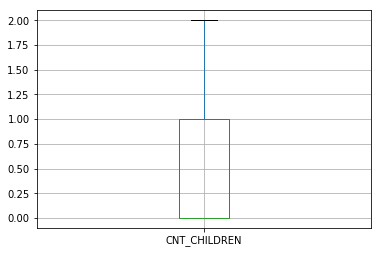

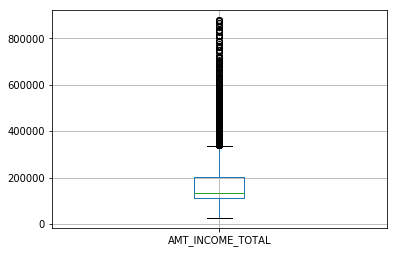

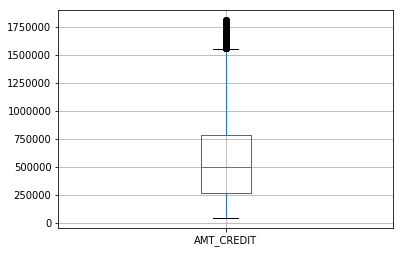

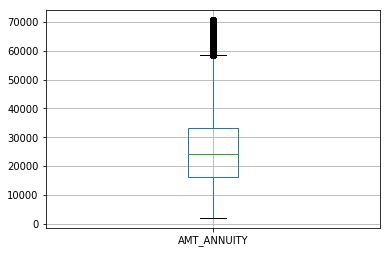

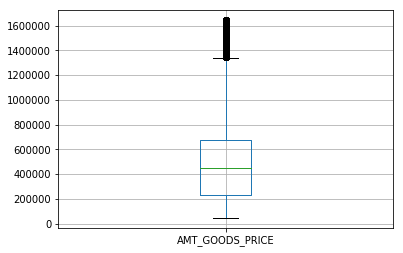

...

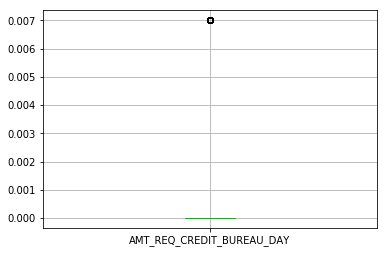

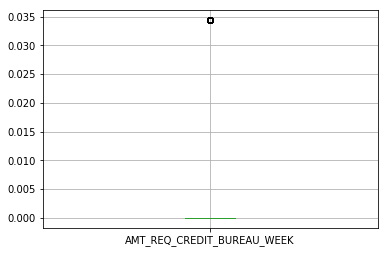

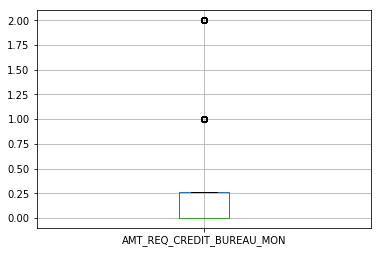

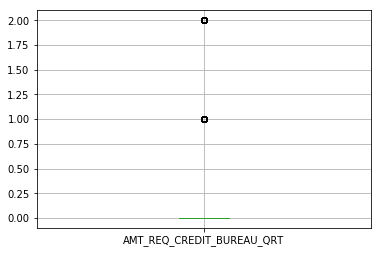

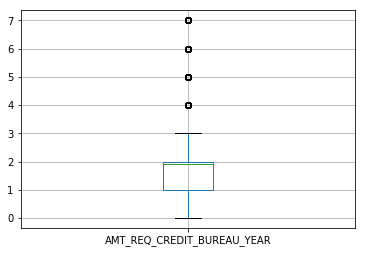

In [37]:
'''
After handling outliers across various columns, lets draw boxplots of numeric columns, and find out if dataframe looks good
Lets visualize them
'''
numeric=["float64", "int64"]
for col in df_updated.select_dtypes(include=numeric).columns:
        plt.figure()
        df_updated.boxplot([col])
        plt.show()


In [38]:
'''
After looking at the boxplots, we can say that outliers have been removed.
There are some columns for which boxplots, still appears very small, but after checking their Standard Deviation, 
we can say that all values greater/less then 3*Standard Deviaton have been removed 
'''
df_updated.head()

,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,CNT_FAM_MEMBERS,HOUR_APPR_PROCESS_START,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,REG_REGION_NOT_WORK_REGION,FLAG_DOCUMENT_12,FLAG_PHONE,FLAG_DOCUMENT_21,NAME_HOUSING_TYPE,NAME_CONTRACT_TYPE,NAME_INCOME_TYPE,ORGANIZATION_TYPE,REG_CITY_NOT_LIVE_CITY,FLAG_DOCUMENT_11,FLAG_CONT_MOBILE,REG_REGION_NOT_LIVE_REGION,REGION_RATING_CLIENT_W_CITY,FLAG_EMP_PHONE,FLAG_DOCUMENT_16,FLAG_DOCUMENT_10,FLAG_OWN_CAR,LIVE_REGION_NOT_WORK_REGION,FLAG_WORK_PHONE,TARGET,FLAG_DOCUMENT_5,FLAG_DOCUMENT_4,FLAG_OWN_REALTY,FLAG_DOCUMENT_15,LIVE_CITY_NOT_WORK_CITY,FLAG_DOCUMENT_17,WEEKDAY_APPR_PROCESS_START,FLAG_DOCUMENT_7,FLAG_DOCUMENT_13,NAME_TYPE_SUITE,FLAG_EMAIL,REG_CITY_NOT_WORK_CITY,FLAG_DOCUMENT_8,FLAG_DOCUMENT_18,NAME_EDUCATION_TYPE,FLAG_DOCUMENT_6,FLAG_MOBIL,CODE_GENDER,FLAG_DOCUMENT_2,FLAG_DOCUMENT_14,FLAG_DOCUMENT_19,NAME_FAMILY_STATUS,REGION_RATING_CLIENT,FLAG_DOCUMENT_3,FLAG_DOCUMENT_20,FLAG_DOCUMENT_9
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
100003,0,270000.0,1293502.5,35698.5,1129500.0,0.003541,-16765,-1188,-1186.0,-291,2.0,11,0.622246,0.510853,1.0,0.0,1.0,0.0,-828.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000,0,0,1,0,House / apartment,Cash loans,State servant,School,0,0,1,0,1,1,0,0,N,0,0,0,0,0,N,0,0,0,MONDAY,0,0,Family,0,0,0,0,Higher education,0,1,F,0,0,0,Married,1,1,0,0
100004,0,67500.0,135000.0,6750.0,135000.0,0.010032,-19046,-225,-4260.0,-2531,1.0,9,0.555912,0.729567,0.0,0.0,0.0,0.0,-815.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000,0,0,1,0,House / apartment,Revolving loans,Working,Government,0,0,1,0,2,1,0,0,Y,0,1,0,0,0,Y,0,0,0,MONDAY,0,0,Unaccompanied,0,0,0,0,Secondary / secondary special,0,1,M,0,0,0,Single / not married,2,0,0,0
100006,0,135000.0,312682.5,29686.5,297000.0,0.008019,-19005,-3039,-9833.0,-2437,2.0,17,0.650442,0.510853,2.0,0.0,2.0,0.0,-617.0,0.006402,0.007,0.034362,0.267395,0.0,1.899974,0,0,0,0,House / apartment,Cash loans,Working,Business Entity Type 3,0,0,1,0,2,1,0,0,N,0,0,0,0,0,Y,0,0,0,WEDNESDAY,0,0,Unaccompanied,0,0,0,0,Secondary / secondary special,0,1,F,0,0,0,Civil marriage,2,1,0,0
100007,0,121500.0,513000.0,21865.5,513000.0,0.028663,-19932,-3038,-4311.0,-3458,1.0,11,0.322738,0.510853,0.0,0.0,0.0,0.0,-1106.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000,0,0,0,0,House / apartment,Cash loans,Working,Religion,0,0,1,0,2,1,0,0,N,0,0,0,0,0,Y,0,1,0,THURSDAY,0,0,Unaccompanied,0,1,1,0,Secondary / secondary special,0,1,M,0,0,0,Single / not married,2,0,0,0
100008,0,99000.0,490495.5,27517.5,454500.0,0.035792,-16941,-1588,-4970.0,-477,2.0,16,0.354225,0.621226,0.0,0.0,0.0,0.0,-2536.0,0.000000,0.000,0.000000,0.000000,1.0,1.000000,0,0,1,0,House / apartment,Cash loans,State servant,Other,0,0,1,0,2,1,0,0,N,0,1,0,0,0,Y,0,0,0,WEDNESDAY,0,0,"Spouse, partner",0,0,0,0,Secondary / secondary special,0,1,M,0,0,0,Married,2,1,0,0


In [39]:
'''
Lets derive some additional metrics which might prove helpful in during analysing process
'''
df_updated["Credit_Vs_Income"] = round(df_updated["AMT_CREDIT"] / df_updated["AMT_INCOME_TOTAL"], 2)
df_updated.head()


,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,CNT_FAM_MEMBERS,HOUR_APPR_PROCESS_START,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,REG_REGION_NOT_WORK_REGION,FLAG_DOCUMENT_12,FLAG_PHONE,FLAG_DOCUMENT_21,NAME_HOUSING_TYPE,NAME_CONTRACT_TYPE,NAME_INCOME_TYPE,ORGANIZATION_TYPE,REG_CITY_NOT_LIVE_CITY,FLAG_DOCUMENT_11,FLAG_CONT_MOBILE,REG_REGION_NOT_LIVE_REGION,REGION_RATING_CLIENT_W_CITY,FLAG_EMP_PHONE,FLAG_DOCUMENT_16,FLAG_DOCUMENT_10,FLAG_OWN_CAR,LIVE_REGION_NOT_WORK_REGION,FLAG_WORK_PHONE,TARGET,FLAG_DOCUMENT_5,FLAG_DOCUMENT_4,FLAG_OWN_REALTY,FLAG_DOCUMENT_15,LIVE_CITY_NOT_WORK_CITY,FLAG_DOCUMENT_17,WEEKDAY_APPR_PROCESS_START,FLAG_DOCUMENT_7,FLAG_DOCUMENT_13,NAME_TYPE_SUITE,FLAG_EMAIL,REG_CITY_NOT_WORK_CITY,FLAG_DOCUMENT_8,FLAG_DOCUMENT_18,NAME_EDUCATION_TYPE,FLAG_DOCUMENT_6,FLAG_MOBIL,CODE_GENDER,FLAG_DOCUMENT_2,FLAG_DOCUMENT_14,FLAG_DOCUMENT_19,NAME_FAMILY_STATUS,REGION_RATING_CLIENT,FLAG_DOCUMENT_3,FLAG_DOCUMENT_20,FLAG_DOCUMENT_9,Credit_Vs_Income
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
100003,0,270000.0,1293502.5,35698.5,1129500.0,0.003541,-16765,-1188,-1186.0,-291,2.0,11,0.622246,0.510853,1.0,0.0,1.0,0.0,-828.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000,0,0,1,0,House / apartment,Cash loans,State servant,School,0,0,1,0,1,1,0,0,N,0,0,0,0,0,N,0,0,0,MONDAY,0,0,Family,0,0,0,0,Higher education,0,1,F,0,0,0,Married,1,1,0,0,4.79
100004,0,67500.0,135000.0,6750.0,135000.0,0.010032,-19046,-225,-4260.0,-2531,1.0,9,0.555912,0.729567,0.0,0.0,0.0,0.0,-815.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000,0,0,1,0,House / apartment,Revolving loans,Working,Government,0,0,1,0,2,1,0,0,Y,0,1,0,0,0,Y,0,0,0,MONDAY,0,0,Unaccompanied,0,0,0,0,Secondary / secondary special,0,1,M,0,0,0,Single / not married,2,0,0,0,2.00
100006,0,135000.0,312682.5,29686.5,297000.0,0.008019,-19005,-3039,-9833.0,-2437,2.0,17,0.650442,0.510853,2.0,0.0,2.0,0.0,-617.0,0.006402,0.007,0.034362,0.267395,0.0,1.899974,0,0,0,0,House / apartment,Cash loans,Working,Business Entity Type 3,0,0,1,0,2,1,0,0,N,0,0,0,0,0,Y,0,0,0,WEDNESDAY,0,0,Unaccompanied,0,0,0,0,Secondary / secondary special,0,1,F,0,0,0,Civil marriage,2,1,0,0,2.32
100007,0,121500.0,513000.0,21865.5,513000.0,0.028663,-19932,-3038,-4311.0,-3458,1.0,11,0.322738,0.510853,0.0,0.0,0.0,0.0,-1106.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000,0,0,0,0,House / apartment,Cash loans,Working,Religion,0,0,1,0,2,1,0,0,N,0,0,0,0,0,Y,0,1,0,THURSDAY,0,0,Unaccompanied,0,1,1,0,Secondary / secondary special,0,1,M,0,0,0,Single / not married,2,0,0,0,4.22
100008,0,99000.0,490495.5,27517.5,454500.0,0.035792,-16941,-1588,-4970.0,-477,2.0,16,0.354225,0.621226,0.0,0.0,0.0,0.0,-2536.0,0.000000,0.000,0.000000,0.000000,1.0,1.000000,0,0,1,0,House / apartment,Cash loans,State servant,Other,0,0,1,0,2,1,0,0,N,0,1,0,0,0,Y,0,0,0,WEDNESDAY,0,0,"Spouse, partner",0,0,0,0,Secondary / secondary special,0,1,M,0,0,0,Married,2,1,0,0,4.95


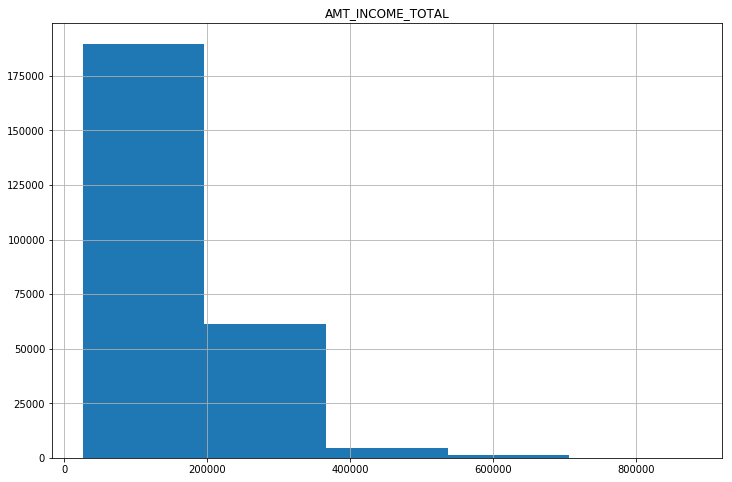

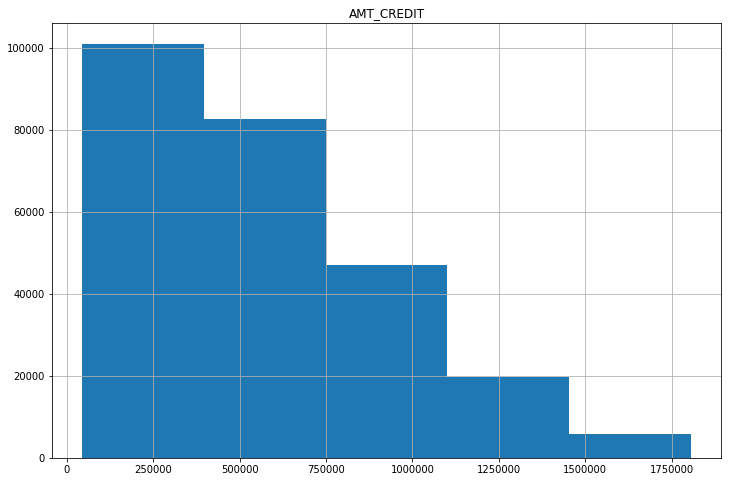

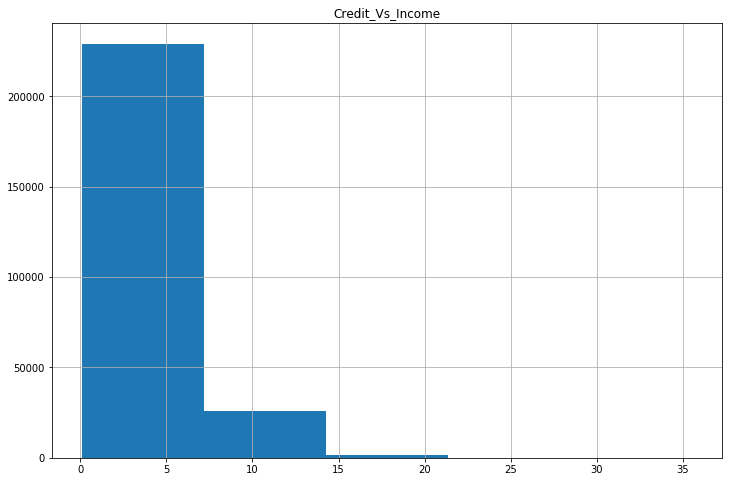

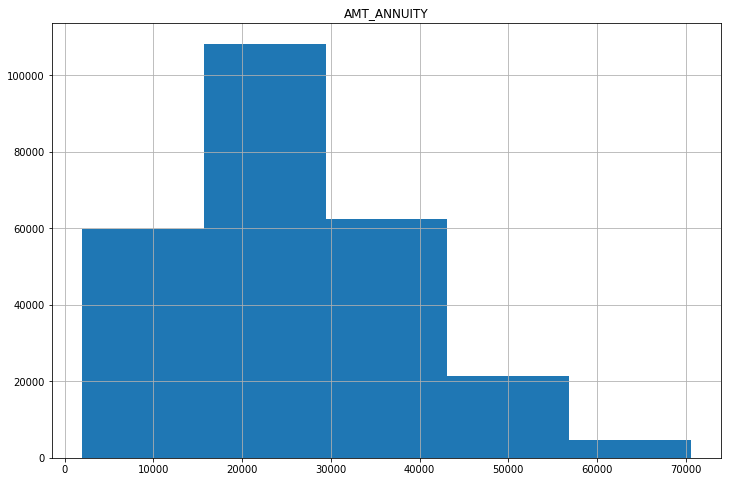

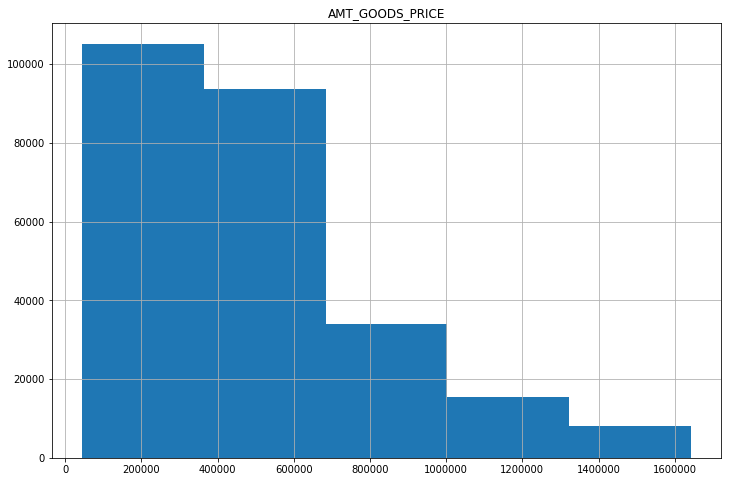

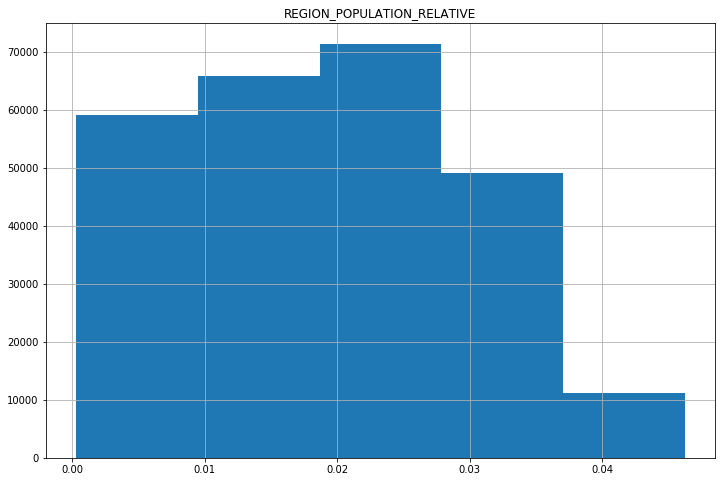

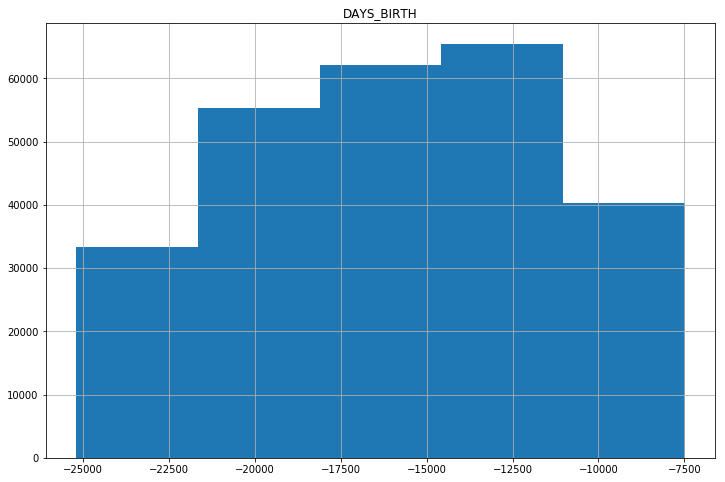

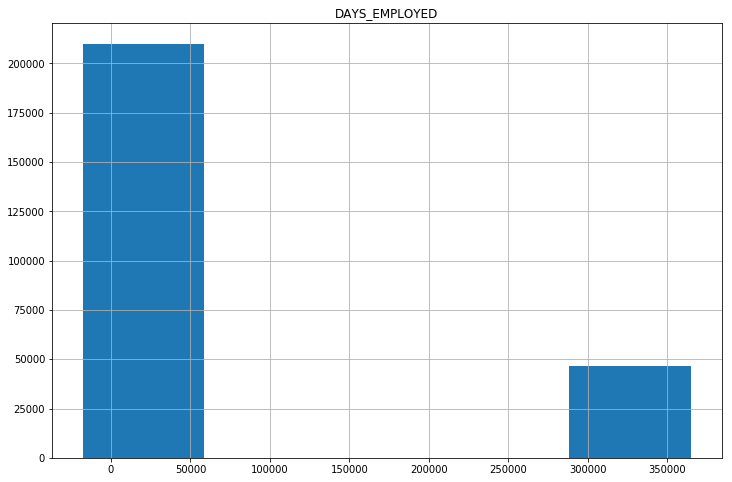

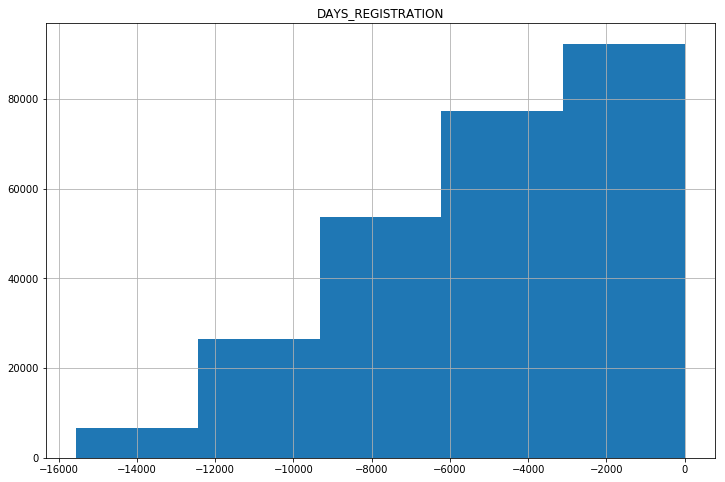

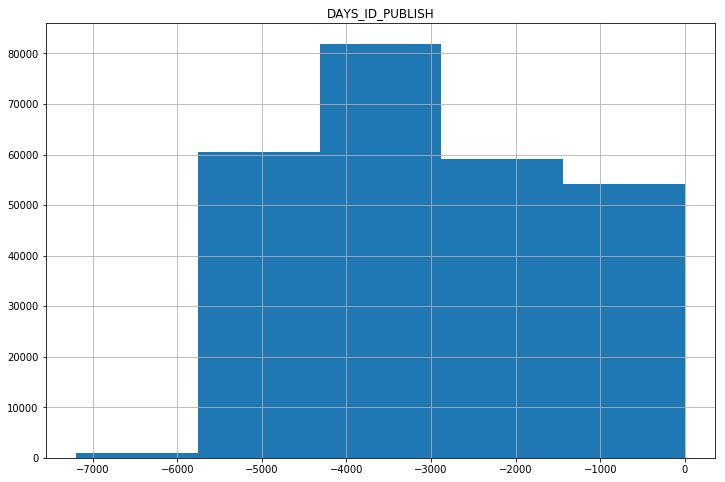

In [40]:
'''
Lets identify some numerical continuous variables, and check their distribution after binning.
It should give us fair idea about will binning be helpful
'''
some_continuous_variables = ["AMT_INCOME_TOTAL", "AMT_CREDIT", "Credit_Vs_Income", "AMT_ANNUITY", "AMT_GOODS_PRICE", 
                           "REGION_POPULATION_RELATIVE", "DAYS_BIRTH", "DAYS_EMPLOYED", "DAYS_REGISTRATION", 
                           "DAYS_ID_PUBLISH"]
for col in some_continuous_variables:
    #sns.distplot(df_updated.loc[:, col]);
    df_updated.hist(col, bins=5, figsize=(12, 8))

In [41]:
'''
After analysing the distribution of various continuos columns, we can notice that 'DAYS_EMPLOYED' column data does not
look accurate even after removing outliers.
So, creating 5 equal bins for following columns only
'''
some_continuous_variables = ["AMT_INCOME_TOTAL", "Credit_Vs_Income", "AMT_CREDIT", "AMT_ANNUITY", "AMT_GOODS_PRICE", 
                           "REGION_POPULATION_RELATIVE", "DAYS_BIRTH", "DAYS_REGISTRATION", "DAYS_ID_PUBLISH"]
for col in some_continuous_variables:
    df_updated[col] = pd.cut(df_updated[col], 5)
    

In [42]:
df_updated.head()

,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,CNT_FAM_MEMBERS,HOUR_APPR_PROCESS_START,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,REG_REGION_NOT_WORK_REGION,FLAG_DOCUMENT_12,FLAG_PHONE,FLAG_DOCUMENT_21,NAME_HOUSING_TYPE,NAME_CONTRACT_TYPE,NAME_INCOME_TYPE,ORGANIZATION_TYPE,REG_CITY_NOT_LIVE_CITY,FLAG_DOCUMENT_11,FLAG_CONT_MOBILE,REG_REGION_NOT_LIVE_REGION,REGION_RATING_CLIENT_W_CITY,FLAG_EMP_PHONE,FLAG_DOCUMENT_16,FLAG_DOCUMENT_10,FLAG_OWN_CAR,LIVE_REGION_NOT_WORK_REGION,FLAG_WORK_PHONE,TARGET,FLAG_DOCUMENT_5,FLAG_DOCUMENT_4,FLAG_OWN_REALTY,FLAG_DOCUMENT_15,LIVE_CITY_NOT_WORK_CITY,FLAG_DOCUMENT_17,WEEKDAY_APPR_PROCESS_START,FLAG_DOCUMENT_7,FLAG_DOCUMENT_13,NAME_TYPE_SUITE,FLAG_EMAIL,REG_CITY_NOT_WORK_CITY,FLAG_DOCUMENT_8,FLAG_DOCUMENT_18,NAME_EDUCATION_TYPE,FLAG_DOCUMENT_6,FLAG_MOBIL,CODE_GENDER,FLAG_DOCUMENT_2,FLAG_DOCUMENT_14,FLAG_DOCUMENT_19,NAME_FAMILY_STATUS,REGION_RATING_CLIENT,FLAG_DOCUMENT_3,FLAG_DOCUMENT_20,FLAG_DOCUMENT_9,Credit_Vs_Income
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
100003,0,"(196020.0, 366390.0]","(1101591.0, 1453788.0]","(29421.0, 43141.5]","(1003500.0, 1323000.0]","(0.000244, 0.00948]","(-18116.2, -14573.8]",-1188,"(-3110.6, 0.0]","(-1439.4, 0.0]",2.0,11,0.622246,0.510853,1.0,0.0,1.0,0.0,-828.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000,0,0,1,0,House / apartment,Cash loans,State servant,School,0,0,1,0,1,1,0,0,N,0,0,0,0,0,N,0,0,0,MONDAY,0,0,Family,0,0,0,0,Higher education,0,1,F,0,0,0,Married,1,1,0,0,"(0.0846, 7.192]"
100004,0,"(24798.15, 196020.0]","(43239.015, 397197.0]","(1911.398, 15700.5]","(43402.5, 364500.0]","(0.00948, 0.0187]","(-21658.6, -18116.2]",-225,"(-6221.2, -3110.6]","(-2878.8, -1439.4]",1.0,9,0.555912,0.729567,0.0,0.0,0.0,0.0,-815.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000,0,0,1,0,House / apartment,Revolving loans,Working,Government,0,0,1,0,2,1,0,0,Y,0,1,0,0,0,Y,0,0,0,MONDAY,0,0,Unaccompanied,0,0,0,0,Secondary / secondary special,0,1,M,0,0,0,Single / not married,2,0,0,0,"(0.0846, 7.192]"
100006,0,"(24798.15, 196020.0]","(43239.015, 397197.0]","(29421.0, 43141.5]","(43402.5, 364500.0]","(0.000244, 0.00948]","(-21658.6, -18116.2]",-3039,"(-12442.4, -9331.8]","(-2878.8, -1439.4]",2.0,17,0.650442,0.510853,2.0,0.0,2.0,0.0,-617.0,0.006402,0.007,0.034362,0.267395,0.0,1.899974,0,0,0,0,House / apartment,Cash loans,Working,Business Entity Type 3,0,0,1,0,2,1,0,0,N,0,0,0,0,0,Y,0,0,0,WEDNESDAY,0,0,Unaccompanied,0,0,0,0,Secondary / secondary special,0,1,F,0,0,0,Civil marriage,2,1,0,0,"(0.0846, 7.192]"
100007,0,"(24798.15, 196020.0]","(397197.0, 749394.0]","(15700.5, 29421.0]","(364500.0, 684000.0]","(0.0278, 0.037]","(-21658.6, -18116.2]",-3038,"(-6221.2, -3110.6]","(-4318.2, -2878.8]",1.0,11,0.322738,0.510853,0.0,0.0,0.0,0.0,-1106.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000,0,0,0,0,House / apartment,Cash loans,Working,Religion,0,0,1,0,2,1,0,0,N,0,0,0,0,0,Y,0,1,0,THURSDAY,0,0,Unaccompanied,0,1,1,0,Secondary / secondary special,0,1,M,0,0,0,Single / not married,2,0,0,0,"(0.0846, 7.192]"
100008,0,"(24798.15, 196020.0]","(397197.0, 749394.0]","(15700.5, 29421.0]","(364500.0, 684000.0]","(0.0278, 0.037]","(-18116.2, -14573.8]",-1588,"(-6221.2, -3110.6]","(-1439.4, 0.0]",2.0,16,0.354225,0.621226,0.0,0.0,0.0,0.0,-2536.0,0.000000,0.000,0.000000,0.000000,1.0,1.000000,0,0,1,0,House / apartment,Cash loans,State servant,Other,0,0,1,0,2,1,0,0,N,0,1,0,0,0,Y,0,0,0,WEDNESDAY,0,0,"Spouse, partner",0,0,0,0,Secondary / secondary special,0,1,M,0,0,0,Married,2,1,0,0,"(0.0846, 7.192]"


In [43]:
df_updated.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 256609 entries, 100003 to 456255
Data columns (total 72 columns):
CNT_CHILDREN                   256609 non-null int64
AMT_INCOME_TOTAL               256609 non-null category
AMT_CREDIT                     256609 non-null category
AMT_ANNUITY                    256609 non-null category
AMT_GOODS_PRICE                256609 non-null category
REGION_POPULATION_RELATIVE     256609 non-null category
DAYS_BIRTH                     256609 non-null category
DAYS_EMPLOYED                  256609 non-null int64
DAYS_REGISTRATION              256609 non-null category
DAYS_ID_PUBLISH                256609 non-null category
CNT_FAM_MEMBERS                256609 non-null float64
HOUR_APPR_PROCESS_START        256609 non-null int64
EXT_SOURCE_2                   256609 non-null float64
EXT_SOURCE_3                   256609 non-null float64
OBS_30_CNT_SOCIAL_CIRCLE       256609 non-null float64
DEF_30_CNT_SOCIAL_CIRCLE       256609 non-null float64
OB

In [44]:
'''
Lets remove columns which only contain single value
'''''
df_updated = df_updated.loc[:,df_updated.apply(pd.Series.nunique) != 1]

In [45]:
'''
As given in problem statement : Target variable (1 - client with payment difficulties: he/she had 
late payment more than X days on at least one of the first Y installments of the loan in our sample, 0 - all other cases)

Lets check what is the shape of our current dataFrame, and what is the proportion of Target varibles present

'''

print("Current shape of data frame is ", df_updated.shape)
print("Current shape of data frame is ", df_updated["TARGET"].value_counts())

Current shape of data frame is  (256609, 71)
Current shape of data frame is  0    235594
1     21015
Name: TARGET, dtype: int64


In [46]:
# Calculating the %age of rows where TARGET=1
print("%age of rows where TARGET=1 is ", 100*df_updated["TARGET"].value_counts()[1]/df_updated.shape[0])

# Calculating the %age of rows where TARGET=0
print("%age of rows where TARGET=0 is ", 100*df_updated["TARGET"].value_counts()[0]/df_updated.shape[0])

%age of rows where TARGET=1 is  8.189502316754284
%age of rows where TARGET=0 is  91.81049768324571


In [47]:
'''
As seen by the counts, there seems to be huge difference between counts of different categorical values.
So, we will be creating two different dataframe based on Target value
'''

df_updated_0 = df_updated[df_updated["TARGET"] == 0]
df_updated_1 = df_updated[df_updated["TARGET"] == 1]

df_updated_0.head()

,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,CNT_FAM_MEMBERS,HOUR_APPR_PROCESS_START,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,REG_REGION_NOT_WORK_REGION,FLAG_DOCUMENT_12,FLAG_PHONE,FLAG_DOCUMENT_21,NAME_HOUSING_TYPE,NAME_CONTRACT_TYPE,NAME_INCOME_TYPE,ORGANIZATION_TYPE,REG_CITY_NOT_LIVE_CITY,FLAG_DOCUMENT_11,FLAG_CONT_MOBILE,REG_REGION_NOT_LIVE_REGION,REGION_RATING_CLIENT_W_CITY,FLAG_EMP_PHONE,FLAG_DOCUMENT_16,FLAG_DOCUMENT_10,FLAG_OWN_CAR,LIVE_REGION_NOT_WORK_REGION,FLAG_WORK_PHONE,TARGET,FLAG_DOCUMENT_5,FLAG_DOCUMENT_4,FLAG_OWN_REALTY,FLAG_DOCUMENT_15,LIVE_CITY_NOT_WORK_CITY,FLAG_DOCUMENT_17,WEEKDAY_APPR_PROCESS_START,FLAG_DOCUMENT_7,FLAG_DOCUMENT_13,NAME_TYPE_SUITE,FLAG_EMAIL,REG_CITY_NOT_WORK_CITY,FLAG_DOCUMENT_8,FLAG_DOCUMENT_18,NAME_EDUCATION_TYPE,FLAG_DOCUMENT_6,CODE_GENDER,FLAG_DOCUMENT_2,FLAG_DOCUMENT_14,FLAG_DOCUMENT_19,NAME_FAMILY_STATUS,REGION_RATING_CLIENT,FLAG_DOCUMENT_3,FLAG_DOCUMENT_20,FLAG_DOCUMENT_9,Credit_Vs_Income
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
100003,0,"(196020.0, 366390.0]","(1101591.0, 1453788.0]","(29421.0, 43141.5]","(1003500.0, 1323000.0]","(0.000244, 0.00948]","(-18116.2, -14573.8]",-1188,"(-3110.6, 0.0]","(-1439.4, 0.0]",2.0,11,0.622246,0.510853,1.0,0.0,1.0,0.0,-828.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000,0,0,1,0,House / apartment,Cash loans,State servant,School,0,0,1,0,1,1,0,0,N,0,0,0,0,0,N,0,0,0,MONDAY,0,0,Family,0,0,0,0,Higher education,0,F,0,0,0,Married,1,1,0,0,"(0.0846, 7.192]"
100004,0,"(24798.15, 196020.0]","(43239.015, 397197.0]","(1911.398, 15700.5]","(43402.5, 364500.0]","(0.00948, 0.0187]","(-21658.6, -18116.2]",-225,"(-6221.2, -3110.6]","(-2878.8, -1439.4]",1.0,9,0.555912,0.729567,0.0,0.0,0.0,0.0,-815.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000,0,0,1,0,House / apartment,Revolving loans,Working,Government,0,0,1,0,2,1,0,0,Y,0,1,0,0,0,Y,0,0,0,MONDAY,0,0,Unaccompanied,0,0,0,0,Secondary / secondary special,0,M,0,0,0,Single / not married,2,0,0,0,"(0.0846, 7.192]"
100006,0,"(24798.15, 196020.0]","(43239.015, 397197.0]","(29421.0, 43141.5]","(43402.5, 364500.0]","(0.000244, 0.00948]","(-21658.6, -18116.2]",-3039,"(-12442.4, -9331.8]","(-2878.8, -1439.4]",2.0,17,0.650442,0.510853,2.0,0.0,2.0,0.0,-617.0,0.006402,0.007,0.034362,0.267395,0.0,1.899974,0,0,0,0,House / apartment,Cash loans,Working,Business Entity Type 3,0,0,1,0,2,1,0,0,N,0,0,0,0,0,Y,0,0,0,WEDNESDAY,0,0,Unaccompanied,0,0,0,0,Secondary / secondary special,0,F,0,0,0,Civil marriage,2,1,0,0,"(0.0846, 7.192]"
100007,0,"(24798.15, 196020.0]","(397197.0, 749394.0]","(15700.5, 29421.0]","(364500.0, 684000.0]","(0.0278, 0.037]","(-21658.6, -18116.2]",-3038,"(-6221.2, -3110.6]","(-4318.2, -2878.8]",1.0,11,0.322738,0.510853,0.0,0.0,0.0,0.0,-1106.0,0.000000,0.000,0.000000,0.000000,0.0,0.000000,0,0,0,0,House / apartment,Cash loans,Working,Religion,0,0,1,0,2,1,0,0,N,0,0,0,0,0,Y,0,1,0,THURSDAY,0,0,Unaccompanied,0,1,1,0,Secondary / secondary special,0,M,0,0,0,Single / not married,2,0,0,0,"(0.0846, 7.192]"
100008,0,"(24798.15, 196020.0]","(397197.0, 749394.0]","(15700.5, 29421.0]","(364500.0, 684000.0]","(0.0278, 0.037]","(-18116.2, -14573.8]",-1588,"(-6221.2, -3110.6]","(-1439.4, 0.0]",2.0,16,0.354225,0.621226,0.0,0.0,0.0,0.0,-2536.0,0.000000,0.000,0.000000,0.000000,1.0,1.000000,0,0,1,0,House / apartment,Cash loans,State servant,Other,0,0,1,0,2,1,0,0,N,0,1,0,0,0,Y,0,0,0,WEDNESDAY,0,0,"Spouse, partner",0,0,0,0,Secondary / secondary special,0,M,0,0,0,Married,2,1,0,0,"(0.0846, 7.192]"


In [48]:
df_updated_1.head()

,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,CNT_FAM_MEMBERS,HOUR_APPR_PROCESS_START,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,REG_REGION_NOT_WORK_REGION,FLAG_DOCUMENT_12,FLAG_PHONE,FLAG_DOCUMENT_21,NAME_HOUSING_TYPE,NAME_CONTRACT_TYPE,NAME_INCOME_TYPE,ORGANIZATION_TYPE,REG_CITY_NOT_LIVE_CITY,FLAG_DOCUMENT_11,FLAG_CONT_MOBILE,REG_REGION_NOT_LIVE_REGION,REGION_RATING_CLIENT_W_CITY,FLAG_EMP_PHONE,FLAG_DOCUMENT_16,FLAG_DOCUMENT_10,FLAG_OWN_CAR,LIVE_REGION_NOT_WORK_REGION,FLAG_WORK_PHONE,TARGET,FLAG_DOCUMENT_5,FLAG_DOCUMENT_4,FLAG_OWN_REALTY,FLAG_DOCUMENT_15,LIVE_CITY_NOT_WORK_CITY,FLAG_DOCUMENT_17,WEEKDAY_APPR_PROCESS_START,FLAG_DOCUMENT_7,FLAG_DOCUMENT_13,NAME_TYPE_SUITE,FLAG_EMAIL,REG_CITY_NOT_WORK_CITY,FLAG_DOCUMENT_8,FLAG_DOCUMENT_18,NAME_EDUCATION_TYPE,FLAG_DOCUMENT_6,CODE_GENDER,FLAG_DOCUMENT_2,FLAG_DOCUMENT_14,FLAG_DOCUMENT_19,NAME_FAMILY_STATUS,REGION_RATING_CLIENT,FLAG_DOCUMENT_3,FLAG_DOCUMENT_20,FLAG_DOCUMENT_9,Credit_Vs_Income
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
100047,0,"(196020.0, 366390.0]","(1101591.0, 1453788.0]","(29421.0, 43141.5]","(684000.0, 1003500.0]","(0.0187, 0.0278]","(-18116.2, -14573.8]",-1262,"(-3110.6, 0.0]","(-1439.4, 0.0]",2.0,9,0.306841,0.320163,0.0,0.0,0.0,0.0,-1075.0,0.0,0.0,0.0,2.0,0.0,4.0,0,0,0,0,House / apartment,Cash loans,Commercial associate,Business Entity Type 3,0,0,1,0,2,1,0,0,N,0,0,1,0,0,Y,0,0,0,TUESDAY,0,0,Unaccompanied,0,0,0,0,Secondary / secondary special,0,M,0,0,0,Married,2,1,0,0,"(0.0846, 7.192]"
100049,0,"(24798.15, 196020.0]","(43239.015, 397197.0]","(15700.5, 29421.0]","(43402.5, 364500.0]","(0.000244, 0.00948]","(-14573.8, -11031.4]",-3597,"(-3110.6, 0.0]","(-5757.6, -4318.2]",2.0,11,0.674203,0.399676,1.0,0.0,1.0,0.0,-1480.0,0.0,0.0,0.0,0.0,0.0,2.0,0,0,1,0,House / apartment,Cash loans,Working,Self-employed,0,0,1,0,3,1,0,0,N,0,1,1,0,0,N,0,0,0,THURSDAY,0,0,Unaccompanied,0,0,0,0,Secondary / secondary special,0,F,0,0,0,Civil marriage,3,1,0,0,"(0.0846, 7.192]"
100096,0,"(24798.15, 196020.0]","(43239.015, 397197.0]","(1911.398, 15700.5]","(43402.5, 364500.0]","(0.0278, 0.037]","(-25218.712, -21658.6]",365243,"(-6221.2, -3110.6]","(-4318.2, -2878.8]",2.0,10,0.023952,0.720944,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,House / apartment,Cash loans,Pensioner,XNA,0,0,1,0,2,0,0,0,N,0,0,1,0,0,Y,0,0,0,THURSDAY,0,0,Unaccompanied,0,0,0,0,Secondary / secondary special,1,F,0,0,0,Married,2,0,0,0,"(0.0846, 7.192]"
100112,0,"(196020.0, 366390.0]","(749394.0, 1101591.0]","(56862.0, 70582.5]","(684000.0, 1003500.0]","(0.0278, 0.037]","(-11031.4, -7489.0]",-2015,"(-6221.2, -3110.6]","(-1439.4, 0.0]",1.0,13,0.432340,0.077499,0.0,0.0,0.0,0.0,-591.0,0.0,0.0,0.0,0.0,0.0,2.0,0,0,0,0,With parents,Cash loans,Commercial associate,Industry: type 4,0,0,1,0,2,1,0,0,Y,0,0,1,0,0,Y,0,1,0,SUNDAY,0,0,Family,0,1,0,0,Incomplete higher,0,M,0,0,0,Single / not married,2,1,0,0,"(0.0846, 7.192]"
100130,1,"(24798.15, 196020.0]","(397197.0, 749394.0]","(29421.0, 43141.5]","(364500.0, 684000.0]","(0.000244, 0.00948]","(-11031.4, -7489.0]",-267,"(-3110.6, 0.0]","(-4318.2, -2878.8]",2.0,12,0.282069,0.120641,0.0,0.0,0.0,0.0,-56.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0,1,0,House / apartment,Cash loans,Commercial associate,Trade: type 2,0,0,1,0,2,1,0,0,N,1,0,1,0,0,Y,0,1,0,SUNDAY,0,0,Unaccompanied,0,1,0,0,Incomplete higher,0,F,0,0,0,Separated,2,1,0,0,"(0.0846, 7.192]"


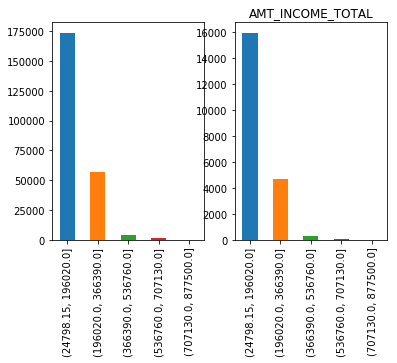

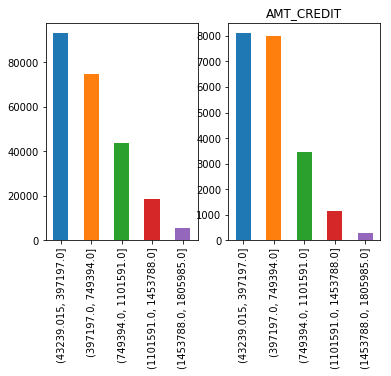

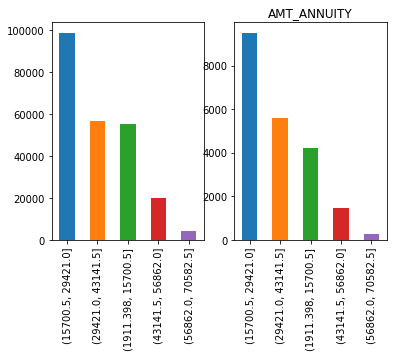

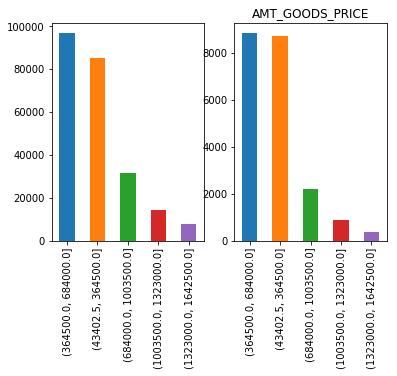

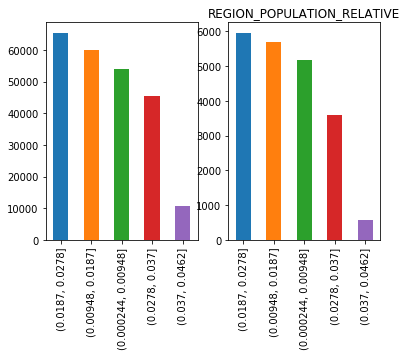

...

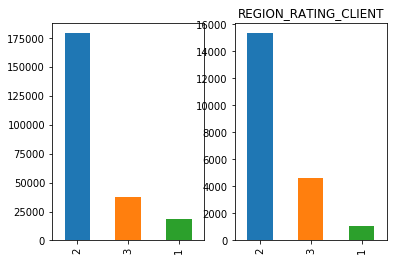

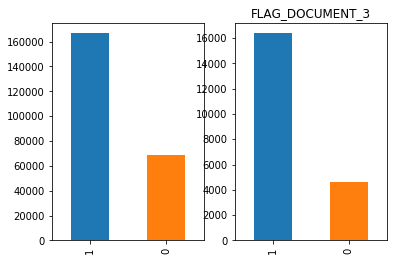

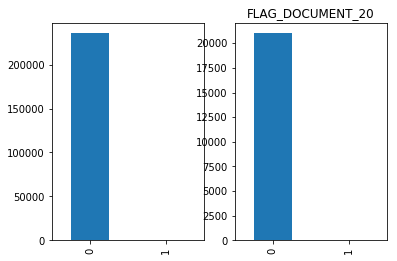

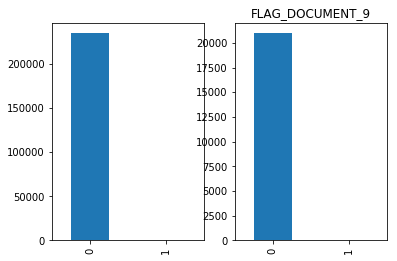

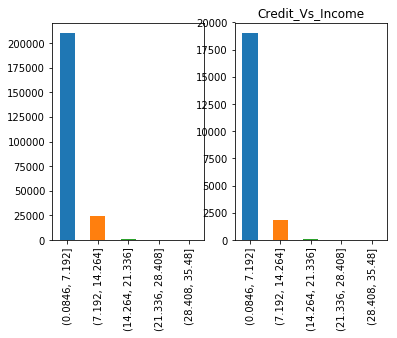

In [49]:
'''
Lets check the frequency of categorical values for df_updated_0 DataFrame and df_updated_1 DataFrame
'''
category=["category"]
for col in df_updated_0.select_dtypes(include=category).columns:
    '''
    Lets keep the x axis same across charts. You would notice that on one graph is y-axis range is smaller compared to 
    other. It is because we have less data for that dataset.
    '''
    fig, axes = plt.subplots(nrows=1, ncols=2, sharex=True)
    df_updated_0[col].value_counts().plot(kind='bar', ax=axes[0])
    df_updated_1[col].value_counts().plot(kind='bar', ax=axes[1])
    plt.title(col)
    plt.show()
    
    

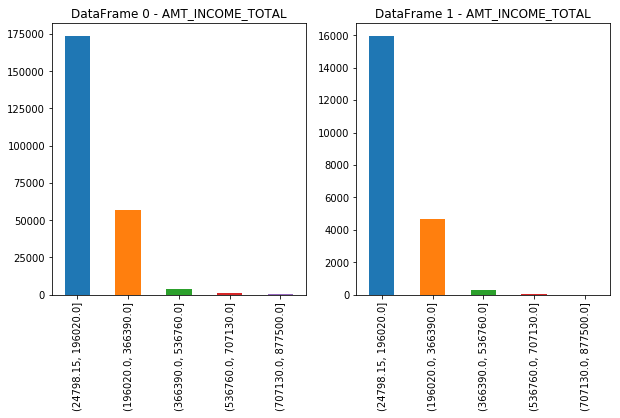

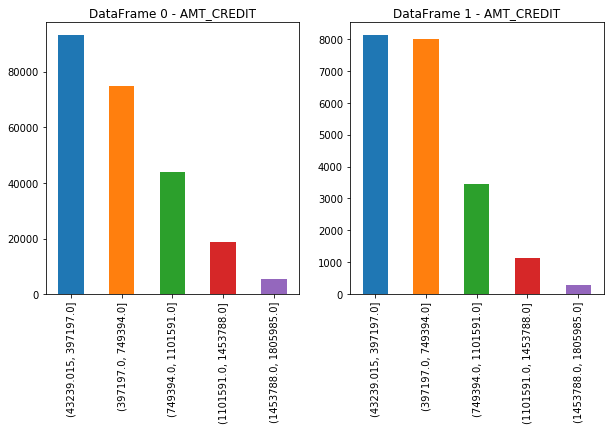

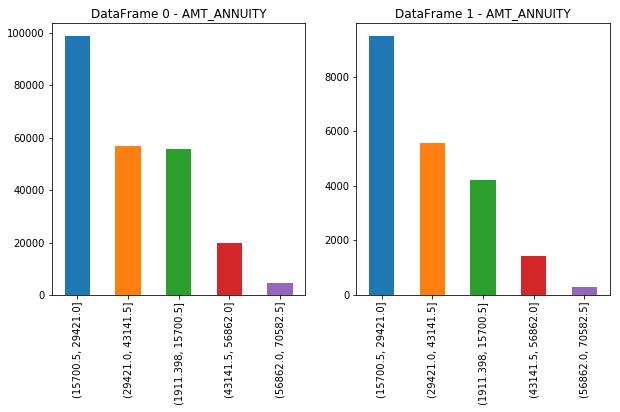

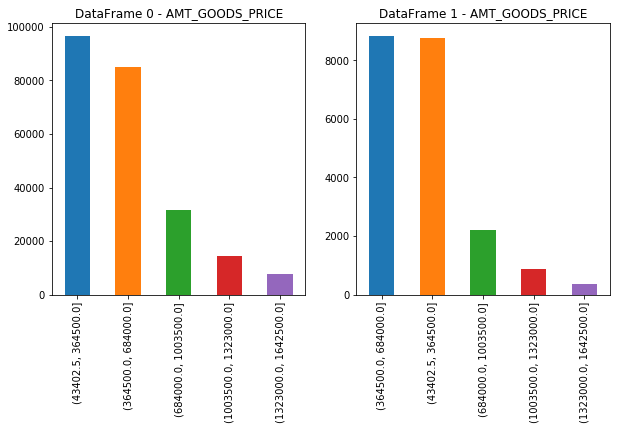

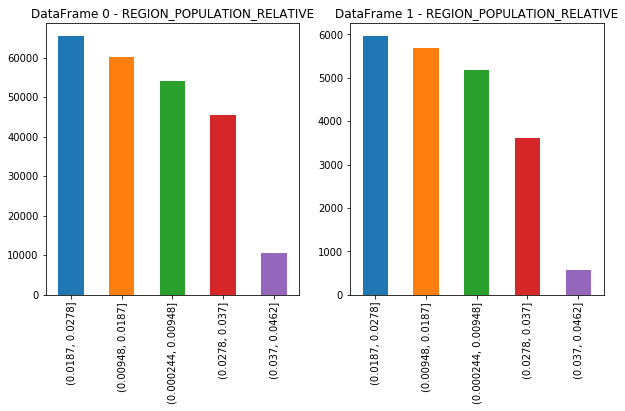

...

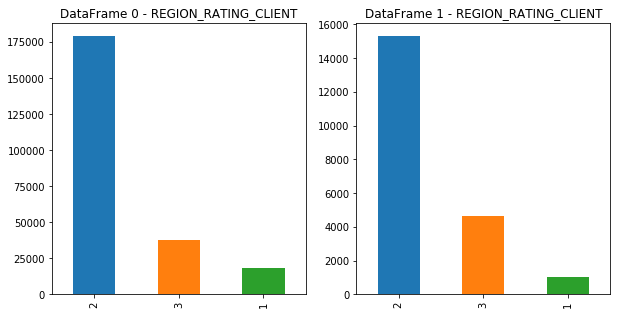

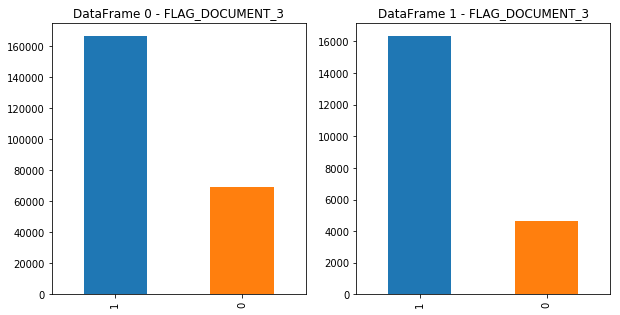

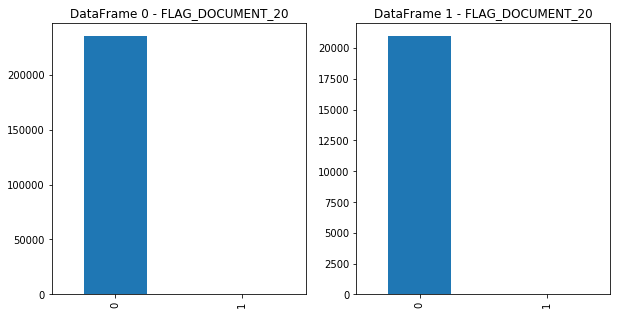

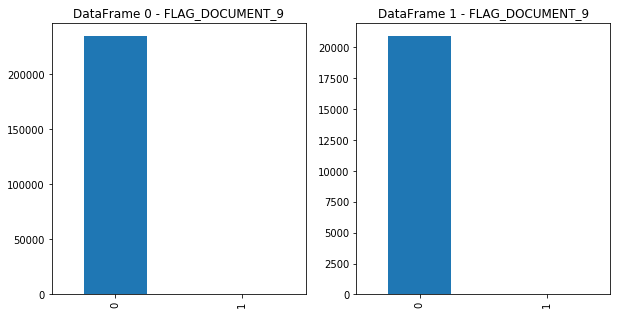

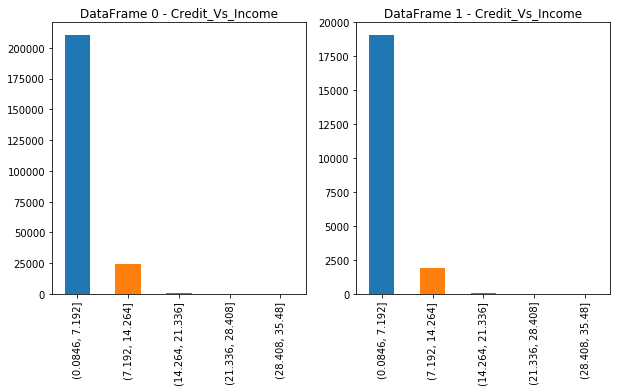

In [50]:
'''
Lets plot same categorical columns but by keeping different axis.
'''
category=["category"]
for col in df_updated_0.select_dtypes(include=category).columns:
    plt.figure(figsize=(10,5))
    plt.subplot(121)
    df_updated_0[col].value_counts().plot(kind='bar', sharex=True)
    plt.title("DataFrame 0 - "+col)
    plt.subplot(122)
    df_updated_1[col].value_counts().plot(kind='bar', sharex=True)
    plt.title("DataFrame 1 - "+col)
    plt.show()

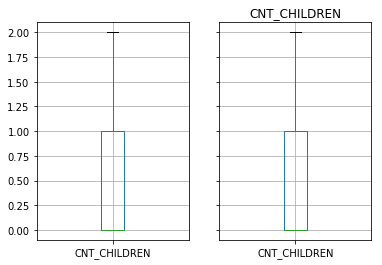

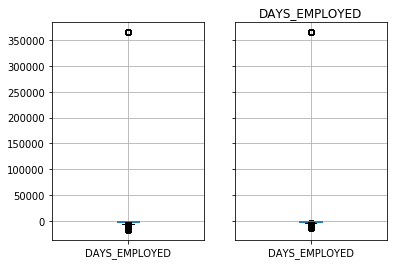

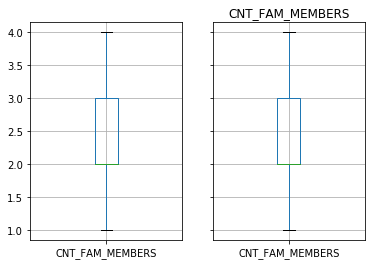

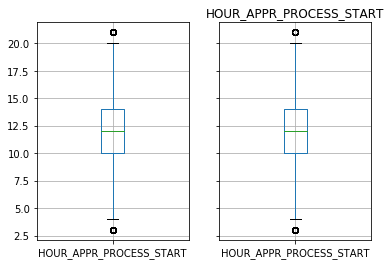

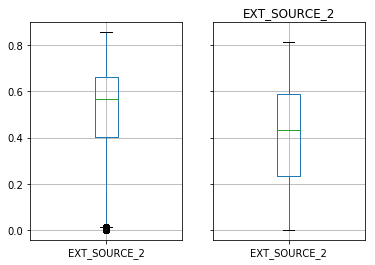

...

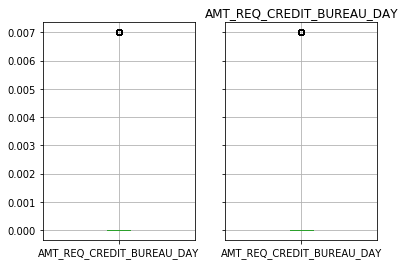

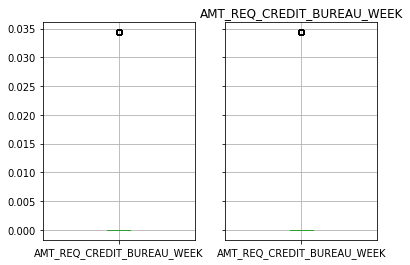

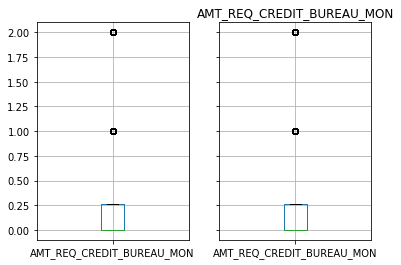

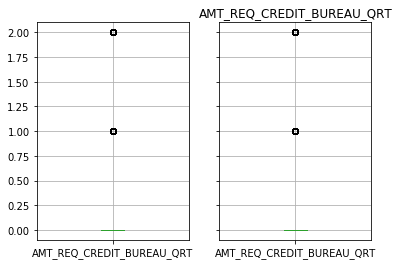

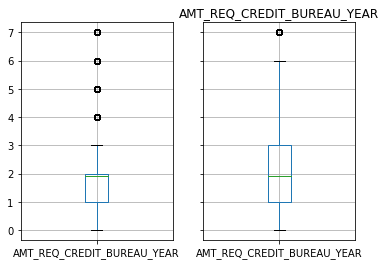

In [51]:
'''
Lets draw boxplots of numeric columns, and find out if dataframe looks good
Lets visualize them
'''
numeric=["float64", "int64"]
for col in df_updated_0.select_dtypes(include=numeric).columns:
    '''
    Lets keep the x axis same across charts. You would notice that one graph is y-axis range is smaller compared to other. 
    It is because we have less data for that dataset.
    '''
    fig, axes = plt.subplots(nrows=1, ncols=2, sharey=True)
    df_updated_0.boxplot([col], ax=axes[0])
    df_updated_1.boxplot([col], ax=axes[1])
    plt.title(col)
    plt.show()


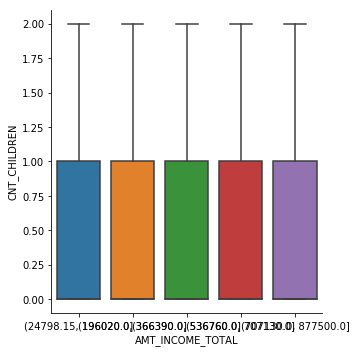

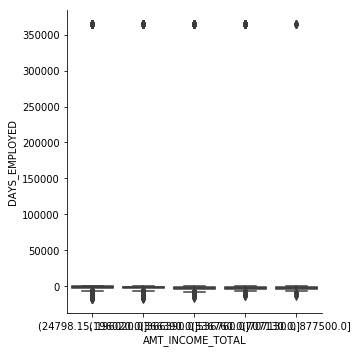

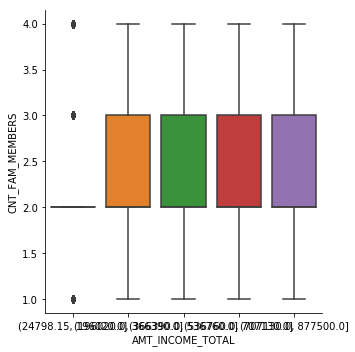

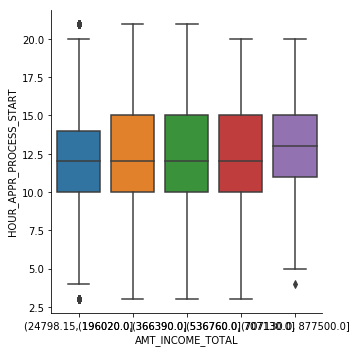

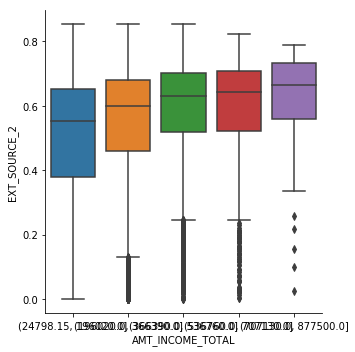

...

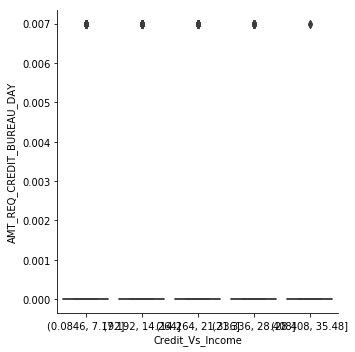

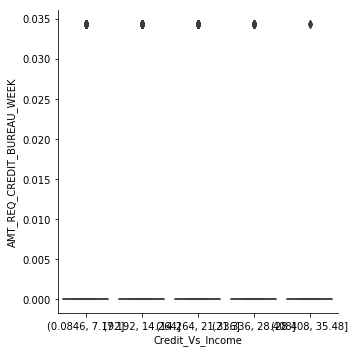

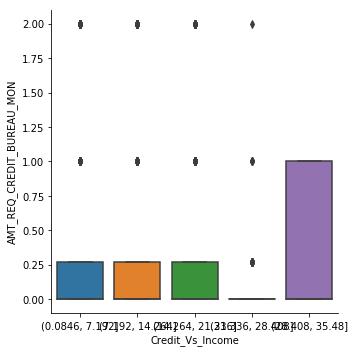

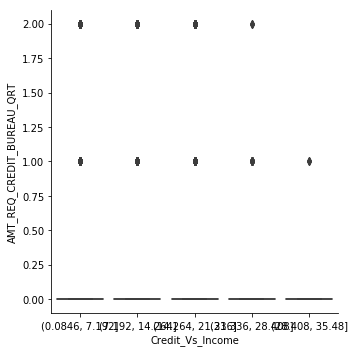

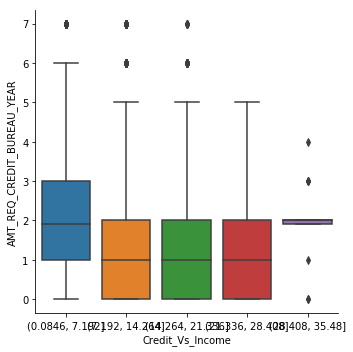

In [52]:
'''
Lets plot all the category columns with numerical columns
'''
category=["category"]
numeric=["float64", "int64"]
for category_col in df_updated_0.select_dtypes(include=category).columns:
    for numeric_col in df_updated_0.select_dtypes(include=numeric).columns:
        sns.catplot(x=category_col, y=numeric_col, kind="box", data=df_updated_0);
        plt.show()

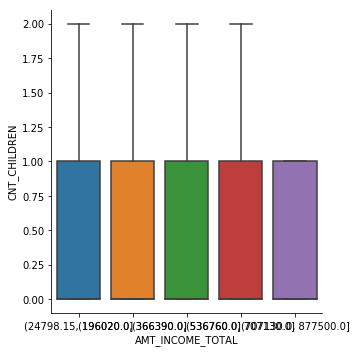

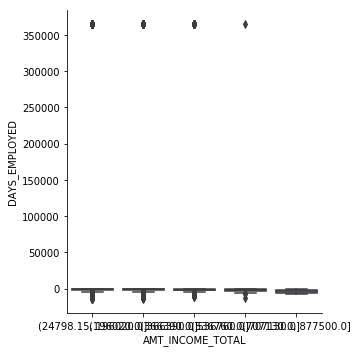

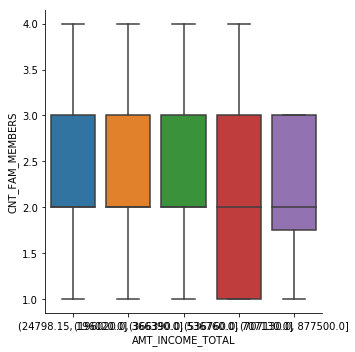

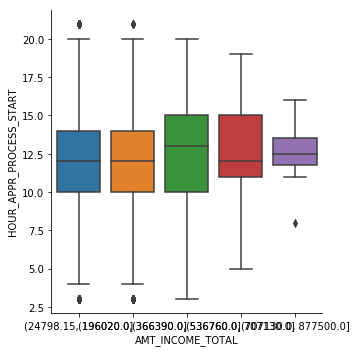

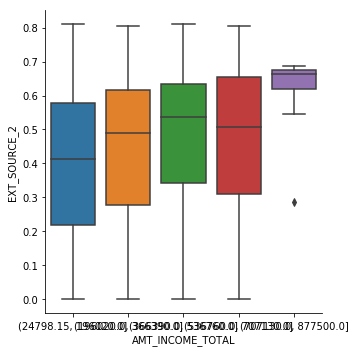

...

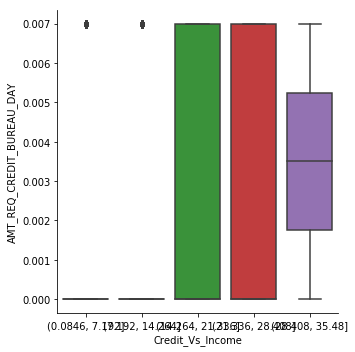

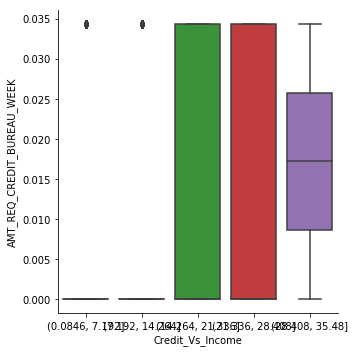

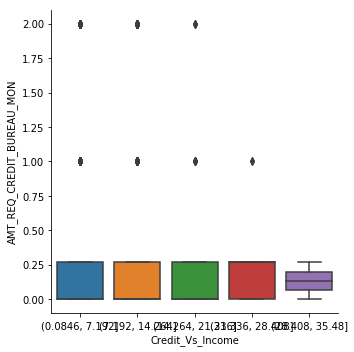

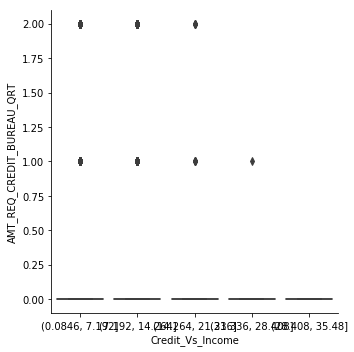

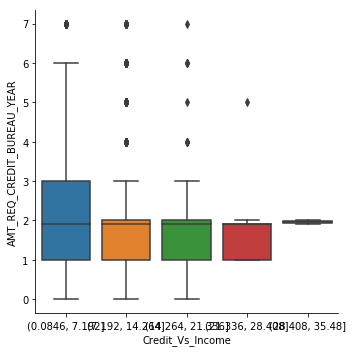

In [53]:
category=["category"]
numeric=["float64", "int64"]
for category_col in df_updated_1.select_dtypes(include=category).columns:
    for numeric_col in df_updated_1.select_dtypes(include=numeric).columns:
        sns.catplot(x=category_col, y=numeric_col, kind="box", data=df_updated_1);
        plt.show()

In [54]:
# Lets find out the correlation matrix on the datasets
loan_correlation_0 = df_updated_0.corr()
loan_correlation_0

,CNT_CHILDREN,DAYS_EMPLOYED,CNT_FAM_MEMBERS,HOUR_APPR_PROCESS_START,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
CNT_CHILDREN,1.000000,-0.253104,0.855997,0.000203,-0.008411,-0.035641,0.022256,0.000617,0.021936,-0.000379,-0.013758,-0.022540,-0.022540,-0.022540,-0.001462,-0.003421,-0.039930
DAYS_EMPLOYED,-0.253104,1.000000,-0.240098,-0.101242,-0.030408,0.098236,-0.000233,0.017702,-0.000048,0.015673,0.028582,0.006414,0.006414,0.006414,-0.029802,0.016648,0.037311
CNT_FAM_MEMBERS,0.855997,-0.240098,1.000000,-0.006114,0.007755,-0.020276,0.030622,-0.000901,0.030336,-0.002860,-0.035148,-0.032683,-0.032683,-0.032683,-0.001125,0.002187,-0.025801
HOUR_APPR_PROCESS_START,0.000203,-0.101242,-0.006114,1.000000,0.149192,-0.038733,-0.002362,-0.004680,-0.002385,-0.007536,-0.008792,-0.016469,-0.016469,-0.016469,0.011004,-0.003713,-0.032076
EXT_SOURCE_2,-0.008411,-0.030408,0.007755,0.149192,1.000000,0.075774,-0.008978,-0.021954,-0.008486,-0.024328,-0.188276,-0.036274,-0.036274,-0.036274,0.016927,0.004929,-0.017410
EXT_SOURCE_3,-0.035641,0.098236,-0.020276,-0.038733,0.075774,1.000000,0.000596,-0.028132,0.000216,-0.025902,-0.064192,-0.022330,-0.022330,-0.022330,-0.021673,-0.012287,-0.056443
OBS_30_CNT_SOCIAL_CIRCLE,0.022256,-0.000233,0.030622,-0.002362,-0.008978,0.000596,1.000000,0.239678,0.997583,0.163077,-0.018923,-0.011194,-0.011194,-0.011194,0.001607,0.003492,0.017239
DEF_30_CNT_SOCIAL_CIRCLE,0.000617,0.017702,-0.000901,-0.004680,-0.021954,-0.028132,0.239678,1.000000,0.241708,0.829218,-0.001127,-0.005439,-0.005439,-0.005439,0.000805,-0.000606,0.011784
OBS_60_CNT_SOCIAL_CIRCLE,0.021936,-0.000048,0.030336,-0.002385,-0.008486,0.000216,0.997583,0.241708,1.000000,0.164975,-0.019302,-0.011262,-0.011262,-0.011262,0.001869,0.003277,0.017664
DEF_60_CNT_SOCIAL_CIRCLE,-0.000379,0.015673,-0.002860,-0.007536,-0.024328,-0.025902,0.163077,0.829218,0.164975,1.000000,0.000030,-0.002302,-0.002302,-0.002302,-0.000288,-0.000493,0.010752


In [55]:
# Lets find out the correlation matrix on the datasets
loan_correlation_1 = df_updated_1.corr()
loan_correlation_1

,CNT_CHILDREN,DAYS_EMPLOYED,CNT_FAM_MEMBERS,HOUR_APPR_PROCESS_START,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
CNT_CHILDREN,1.000000,-0.198990,0.859600,-0.026413,-0.006238,-0.027914,0.037333,0.002303,0.037270,-0.001756,0.007582,-0.017867,-0.017867,-0.017867,-0.011577,-0.017284,-0.030002
DAYS_EMPLOYED,-0.198990,1.000000,-0.187511,-0.061147,-0.003975,0.078070,-0.013458,-0.002739,-0.014085,0.000686,0.004947,0.004367,0.004367,0.004367,-0.025007,0.015897,0.023392
CNT_FAM_MEMBERS,0.859600,-0.187511,1.000000,-0.029838,0.008169,-0.031507,0.054266,0.006436,0.053965,-0.000176,-0.018674,-0.042206,-0.042206,-0.042206,-0.014025,-0.003734,-0.006972
HOUR_APPR_PROCESS_START,-0.026413,-0.061147,-0.029838,1.000000,0.127310,-0.052558,-0.016307,-0.003612,-0.016013,-0.002342,-0.015009,-0.033123,-0.033123,-0.033123,0.010705,0.007579,-0.025213
EXT_SOURCE_2,-0.006238,-0.003975,0.008169,0.127310,1.000000,0.046941,0.023051,-0.013435,0.023320,-0.009147,-0.202658,-0.066594,-0.066594,-0.066594,0.018287,0.010973,0.007328
EXT_SOURCE_3,-0.027914,0.078070,-0.031507,-0.052558,0.046941,1.000000,-0.009165,-0.018119,-0.009314,-0.012818,-0.039201,0.227402,0.227402,0.227402,-0.003719,-0.073658,-0.041923
OBS_30_CNT_SOCIAL_CIRCLE,0.037333,-0.013458,0.054266,-0.016307,0.023051,-0.009165,1.000000,0.255996,0.997354,0.176995,-0.037444,-0.017959,-0.017959,-0.017959,-0.007852,-0.001501,0.031440
DEF_30_CNT_SOCIAL_CIRCLE,0.002303,-0.002739,0.006436,-0.003612,-0.013435,-0.018119,0.255996,1.000000,0.259615,0.839743,0.000527,0.004328,0.004328,0.004328,-0.005388,0.000035,0.000537
OBS_60_CNT_SOCIAL_CIRCLE,0.037270,-0.014085,0.053965,-0.016013,0.023320,-0.009314,0.997354,0.259615,1.000000,0.180194,-0.038195,-0.018404,-0.018404,-0.018404,-0.007710,-0.002459,0.031187
DEF_60_CNT_SOCIAL_CIRCLE,-0.001756,0.000686,-0.000176,-0.002342,-0.009147,-0.012818,0.176995,0.839743,0.180194,1.000000,0.004369,0.009002,0.009002,0.009002,-0.005823,0.002976,-0.006052


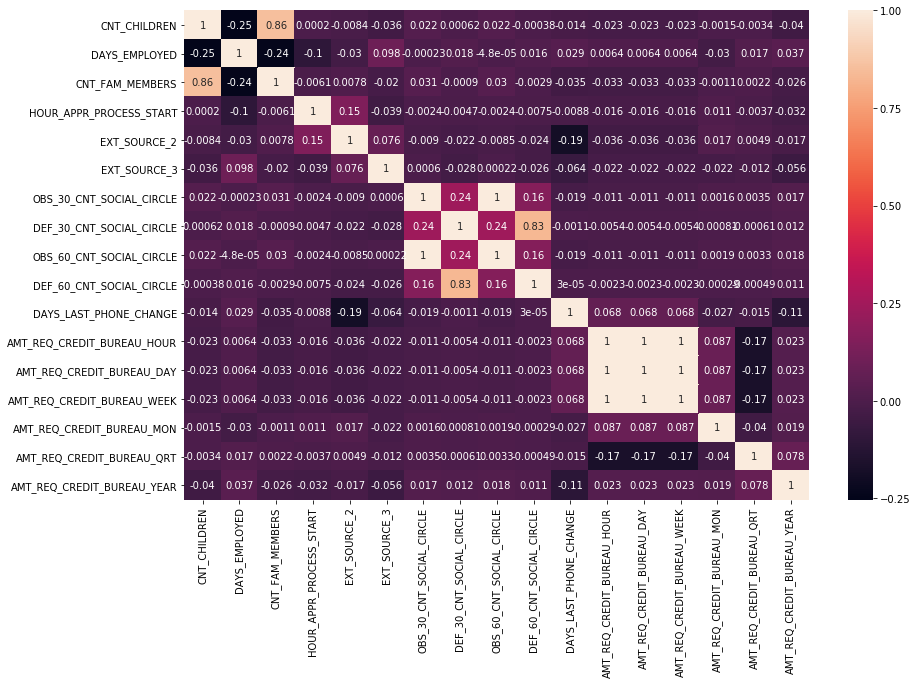

In [56]:
# Plotting the correlation matrix
f, ax = plt.subplots(figsize=(14, 9))
sns.heatmap(loan_correlation_0, 
            xticklabels=loan_correlation_0.columns.values,
            yticklabels=loan_correlation_0.columns.values,annot= True)
plt.show()

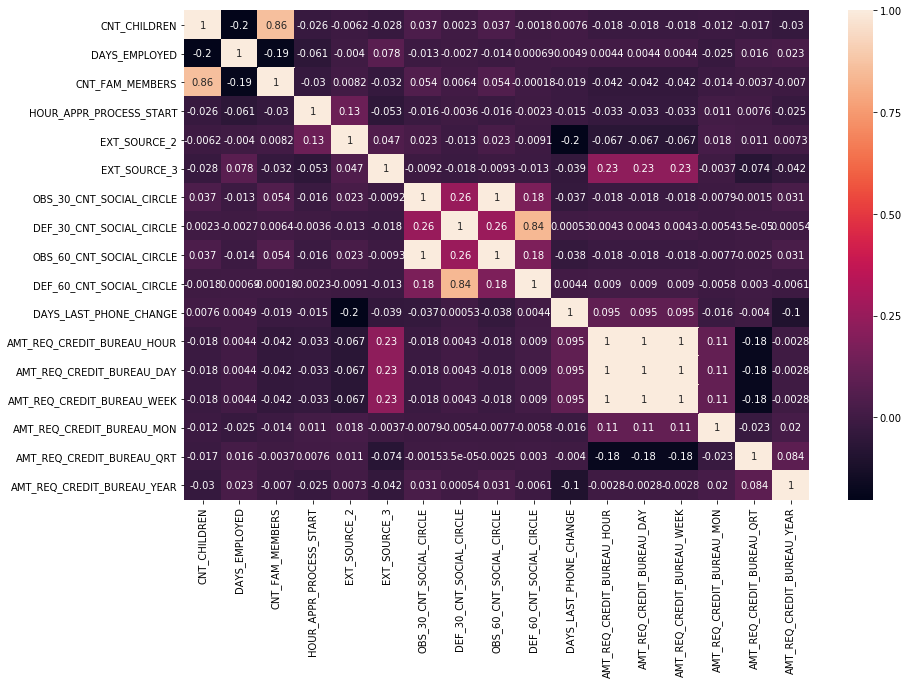

In [57]:
# Plotting the correlation matrix
f, ax = plt.subplots(figsize=(14, 9))
sns.heatmap(loan_correlation_1, 
            xticklabels=loan_correlation_1.columns.values,
            yticklabels=loan_correlation_1.columns.values,annot= True)
plt.show()

In [58]:
'''
Lets read Previous application data and lets see if we see the same behaviour
'''


'\nLets read Previous application data and lets see if we see the same behaviour\n'